# Preexperiment for embedding digits
* Bispectrum OT performs much better for rotated images while the usual feature OT performs marginally better for unrotated images

In [2]:
import torchvision
import torchvision.transforms as transforms
import torchvision.transforms.functional as TF
import torchvision.datasets as dset
from scipy.spatial.distance import cdist
from torchvision.transforms import ToPILImage, ToTensor
from PIL import Image
from sklearn.manifold import MDS
from collections import Counter, defaultdict
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from pathlib import Path
from scipy.spatial.distance import cdist


In [11]:
from angular_bispectrum import *
from data_processing import *

In [12]:
DATA_DIR = Path.cwd() / "datasets"
DATA_DIR.mkdir(parents=True, exist_ok=True)
mnist = torchvision.datasets.MNIST(root=str(DATA_DIR), download = True, transform = build_transform())

# Functions

In [13]:
#build a dataset, where we take 10 digits, one from each class, and rotate them angle=30 degrees around the circle and return the dataset 
def extract_rotated_dataset(data, angle_step=30, prototypes_per_digit=1, seed=0):
    rng = np.random.RandomState(seed)
    angles = list(range(0, 360, angle_step))

    buckets = defaultdict(list)
    for img, lbl in data:
        buckets[int(lbl)].append(img)

    samples = []
    for d in range(10):
        imgs = buckets[d]
        idxs = rng.choice(len(imgs), prototypes_per_digit, replace=False)
        for i in idxs:
            img = imgs[i]
            for ang in angles:
                rot = rotate_degree(img, ang)
                samples.append((torch.squeeze(rot), d, ang))
    return samples

def prepare_bispec_embed(data, angle=30, prototypes_per_digit=1, seed=0, num_angles=40):
    rot_data = extract_rotated_dataset(
        data, angle_step=angle,
        prototypes_per_digit=prototypes_per_digit,
        seed=seed
    )

    ys     = [lbl for (_, lbl, _) in rot_data]
    xs     = [img for (img, _, _) in rot_data]
    angles = [ang for (_, _, ang) in rot_data]

    bis = PolarBispec(num_angles)
    bs  = [torch.stack([bis.bispec(x).real, bis.bispec(x).imag])
           for x in xs]

    return {"ys": ys, "xs": xs, "bs": bs, "angles": angles}


In [14]:
def _to_display_image(x):
    if isinstance(x, torch.Tensor):
        x = x.detach().cpu().numpy()
    x = np.asarray(x)
    if x.ndim == 3 and x.shape[0] == 1:      # (1,H,W) -> (H,W)
        x = x[0]
    if x.ndim == 3 and x.shape[-1] == 1:     # (H,W,1) -> (H,W)
        x = x[..., 0]
    # normalize per image if not already 0..1
    x = x.astype("float32")
    mn, mx = x.min(), x.max()
    if mx > mn:
        x = (x - mn) / (mx - mn)
    else:
        x = np.zeros_like(x, dtype="float32")
    return x

def run_experiment(dataset, angle=30, use_bispec=True, random_seed=0, dimension=2, prototypes_per_digit=1):
    data = prepare_bispec_embed(dataset, angle, prototypes_per_digit, random_seed)

    labels = np.array(data["ys"])
    angles_per_sample = np.array(data["angles"])

    raw_feats = data["bs"] if use_bispec else data["xs"]

    features = np.stack([
        f.flatten().numpy() if isinstance(f, torch.Tensor) else np.asarray(f).flatten()
        for f in raw_feats
    ])

    display_imgs = [ _to_display_image(x) for x in data["xs"] ]

    mds = MDS(n_components=dimension, random_state=random_seed, dissimilarity="euclidean")
    embedding = mds.fit_transform(features)
    
    return embedding, labels, angles_per_sample, features, display_imgs


In [15]:
def avg_same_class_distance(embedding, labels):
    #what the function is called 
    diffs = embedding[:, None, :] - embedding[None, :, :]   
    dists = np.sqrt((diffs**2).sum(axis=2))                 

    iu, ju = np.triu_indices(dists.shape[0], k=1)

    same_mask = labels[iu] == labels[ju]
    same_dists = dists[iu, ju][same_mask]

    return same_dists.mean()


In [16]:
def draw_embedding_as_thumbnails(ax, points, images, labels=None, zoom=0.75, cmap_name="tab10", linewidth=1.2):
    points = np.asarray(points)
    ax.set_xticks([]); ax.set_yticks([])
    cmap = plt.get_cmap(cmap_name)

    ax.set_autoscale_on(False)

    for i, ((x0, y0), img) in enumerate(zip(points, images)):
        if img.ndim == 2:
            oi = OffsetImage(img, zoom=zoom, cmap="gray", dpi_cor=True)
        else:
            oi = OffsetImage(img, zoom=zoom, dpi_cor=True)

        edgecolor = cmap(int(labels[i]) % cmap.N) if labels is not None else (0, 0, 0, 1)
        ab = AnnotationBbox(
            oi, (x0, y0),
            frameon=True,
            pad=0,
            bboxprops=dict(edgecolor=edgecolor, linewidth=linewidth, boxstyle="round,pad=0.1")
        )
        ax.add_artist(ab)

In [17]:
def set_limits_for_thumbnails(ax, pts, images, zoom, pad_scale=1.0, extra_px=1):
    pts = np.asarray(pts)
    x = pts[:, 0]; y = pts[:, 1]
    xmin, xmax = float(x.min()), float(x.max())
    ymin, ymax = float(y.min()), float(y.max())

    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.figure.canvas.draw()  

    p0  = ax.transData.transform((0, 0))
    p1x = ax.transData.transform((1, 0))
    p1y = ax.transData.transform((0, 1))
    px_per_data_x = (p1x[0] - p0[0]) or 1.0
    px_per_data_y = abs(p1y[1] - p0[1]) or 1.0
    data_per_px_x = 1.0 / px_per_data_x
    data_per_px_y = 1.0 / px_per_data_y
    h = max(img.shape[0] for img in images)
    w = max(img.shape[1] for img in images)
    pad_x = pad_scale * (0.5 * w * zoom + extra_px) * data_per_px_x
    pad_y = pad_scale * (0.5 * h * zoom + extra_px) * data_per_px_y

    ax.set_xlim(xmin - pad_x, xmax + pad_x)
    ax.set_ylim(ymin - pad_y, ymax + pad_y)
    ax.set_autoscale_on(False)

# 2D MDS Embeddings for 10 Random Seeds, 1 digit from each class, Rotated by Z/40Z

In [18]:
embedding_bispec_list = []
embedding_raw_list = []
angles_bispec_list = []
angles_raw_list   = []
images_raw_list   = []            

agg_counts = defaultdict(Counter) 
seeds = list(range(10))

for seed in seeds:
    emb_b, labels, ang_b, _, imgs_b = run_experiment(
        mnist, angle=9, use_bispec=True, random_seed=seed
    )
    embedding_bispec_list.append(emb_b)
    angles_bispec_list.append(ang_b)

    emb_r, _, ang_r, _, imgs_r = run_experiment(
        mnist, angle=9, use_bispec=False, random_seed=seed
    )
    embedding_raw_list.append(emb_r)
    angles_raw_list.append(ang_r)

    images_raw_list.append(imgs_r)

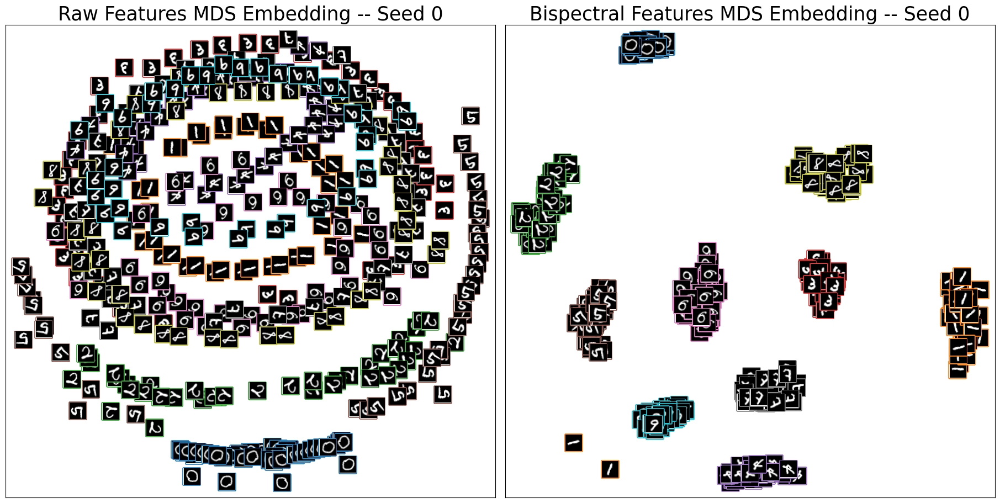

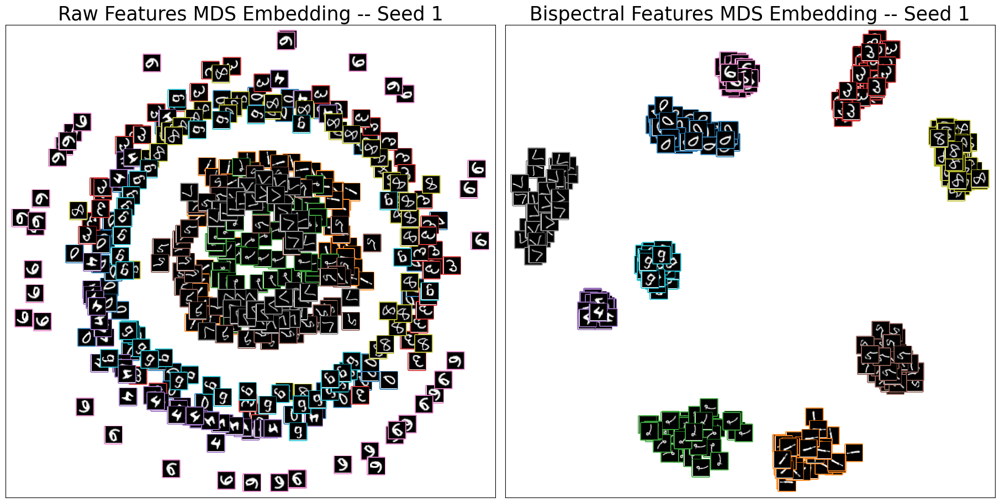

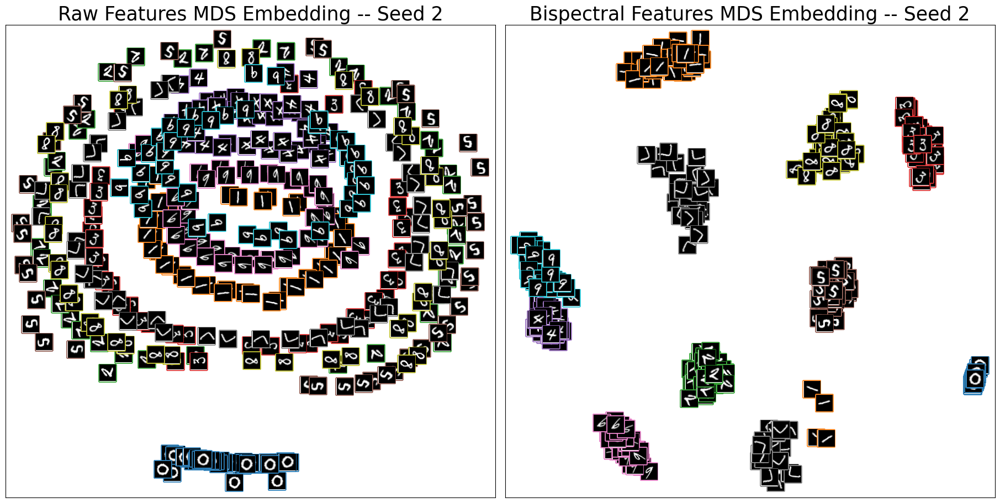

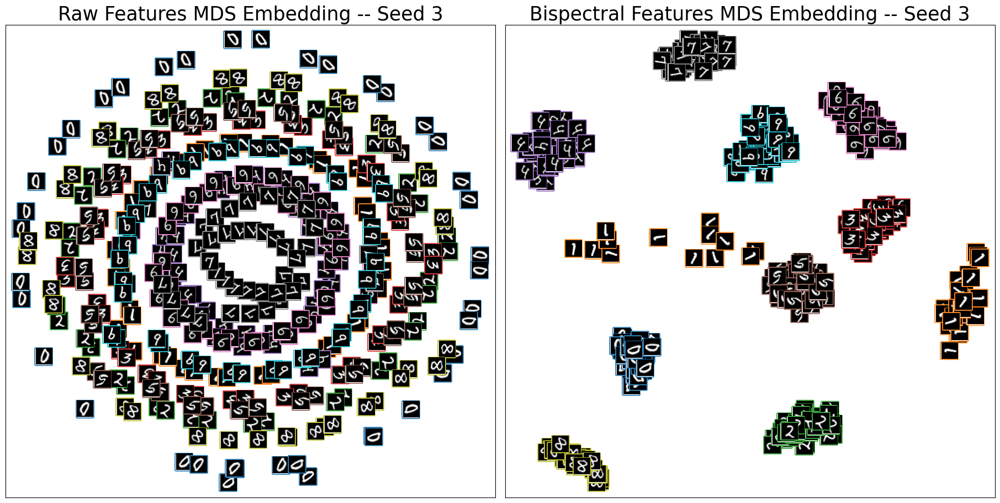

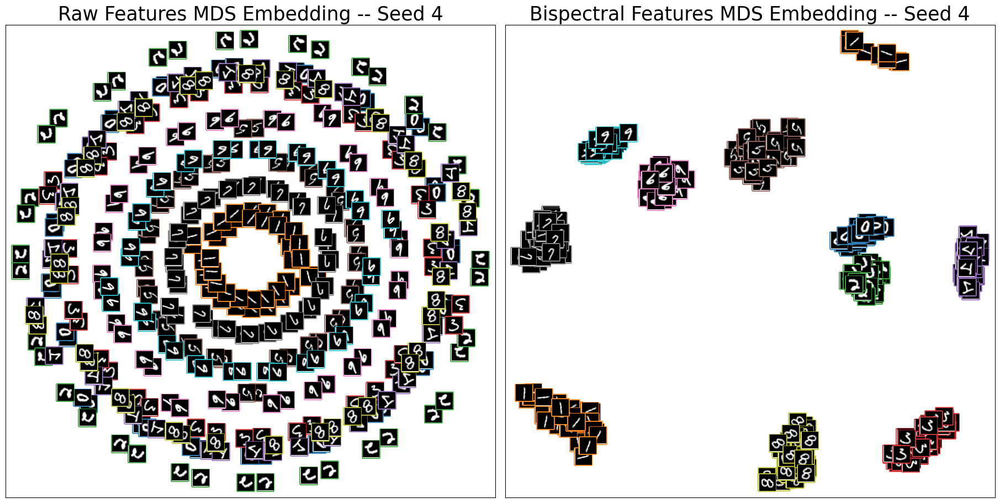

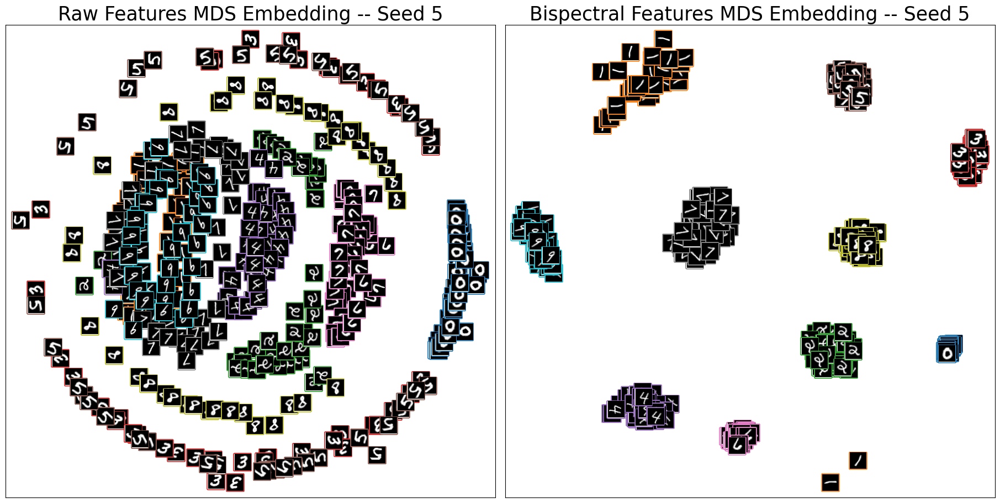

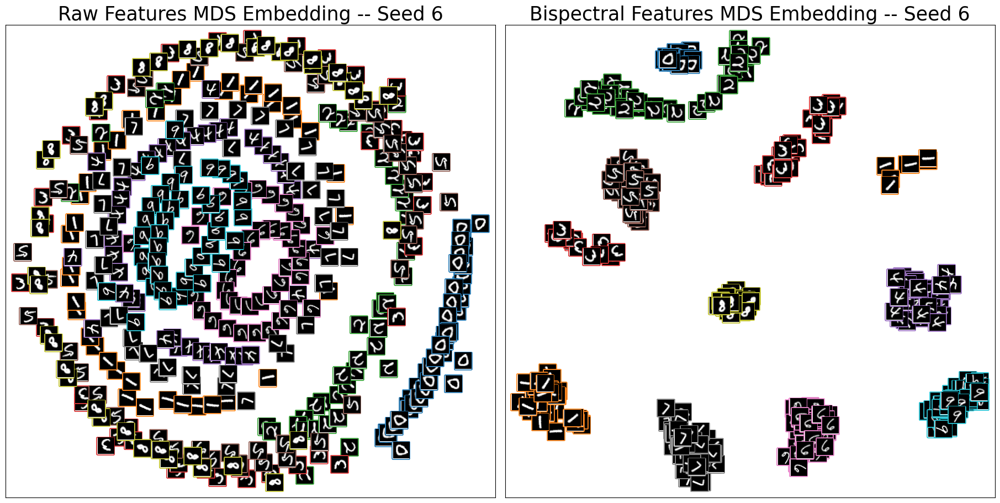

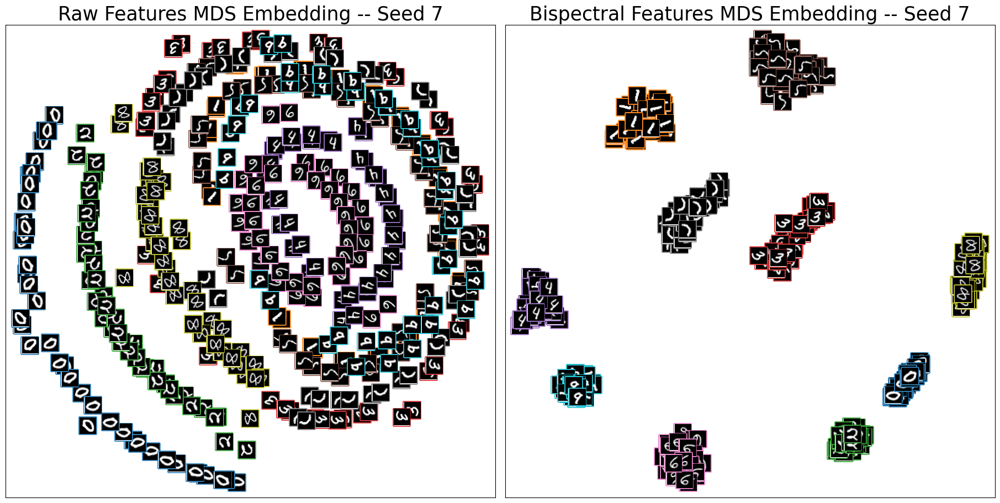

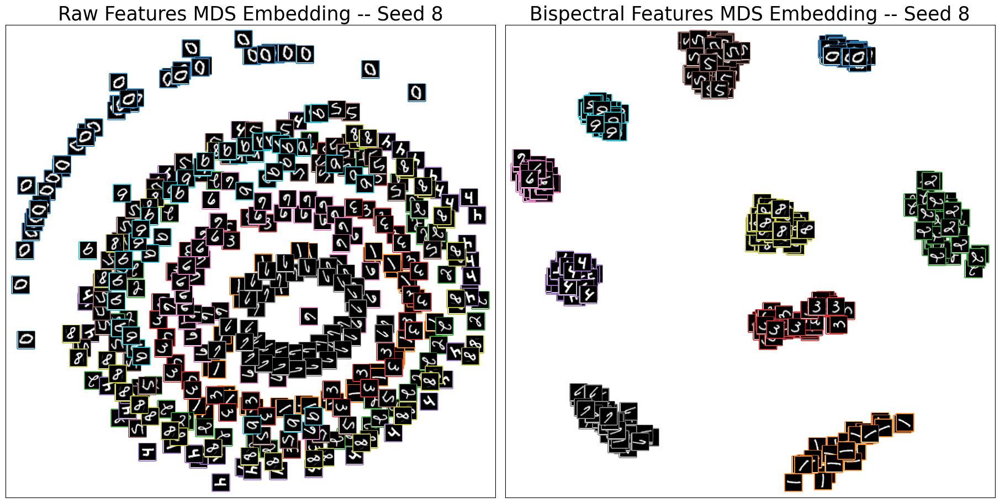

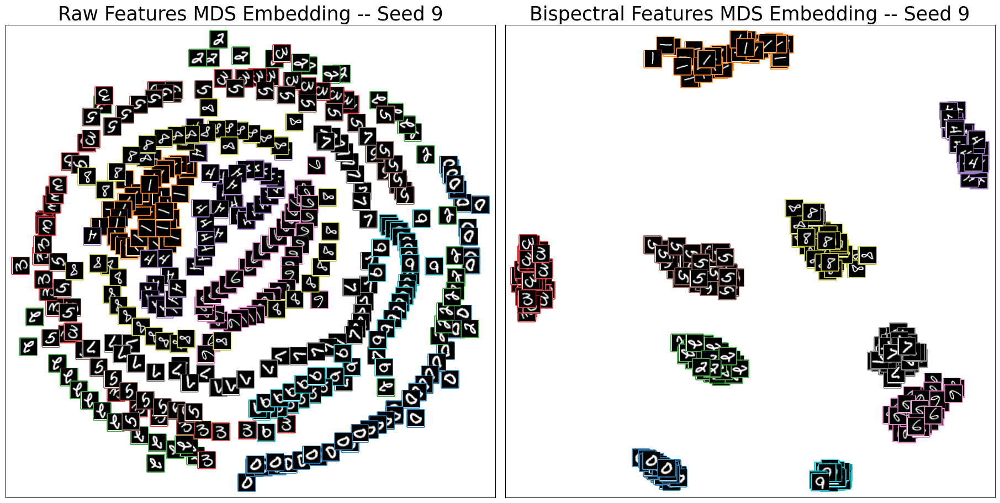

In [20]:
photo_path = str(Path.cwd() / "experiment_photos/1digitmds")
for seed_idx, seed in enumerate(seeds):
    fig, axs = plt.subplots(1, 2, figsize=(18, 9), constrained_layout=True)

    axs[0].set_title(f"Raw Features MDS Embedding -- Seed {seed}", fontsize=25)
    set_limits_for_thumbnails(axs[0],
                              embedding_raw_list[seed_idx],
                              images_raw_list[seed_idx],
                              zoom=0.75,
                              pad_scale=2.4)   
    draw_embedding_as_thumbnails(axs[0],
                                 embedding_raw_list[seed_idx],
                                 images_raw_list[seed_idx],
                                 labels=labels,
                                 zoom=0.75)

    axs[1].set_title(f"Bispectral Features MDS Embedding -- Seed {seed}", fontsize=25)
    set_limits_for_thumbnails(axs[1],
                              embedding_bispec_list[seed_idx],
                              images_raw_list[seed_idx],
                              zoom=0.75,
                              pad_scale=2.4)   
    draw_embedding_as_thumbnails(axs[1],
                                 embedding_bispec_list[seed_idx],
                                 images_raw_list[seed_idx],
                                 labels=labels,
                                 zoom=0.75)
    
    save_path = os.path.join(photo_path, f"1_digit_angle9_mds_embedding_seed_{seed}.png")
    plt.savefig(save_path)

    plt.show()


# Sampling 10 digits from each class

## Visualizations

In [29]:
embedding_bispec_10_digits = []
embedding_raw_10_digits = []

angles_bispec_10_digits = []
angles_raw_10_digits = []

seeds = list(range(0, 10, 2))

for s in seeds:
    print('start')
    emb_b, labels_10, ang_b, _, _ = run_experiment(mnist, angle=9, use_bispec=True, random_seed=s, dimension=2, prototypes_per_digit=10)
    print('done')
    embedding_bispec_10_digits.append(emb_b)
    angles_bispec_10_digits.append(ang_b)

    print('start')
    emb_r, _, ang_r, _, _ = run_experiment(mnist, angle=9, use_bispec=False, random_seed=s, dimension=2, prototypes_per_digit=10)
    print('done')
    embedding_raw_10_digits.append(emb_r)
    angles_raw_10_digits.append(ang_r)

start
done
start
done
start
done
start
done
start
done
start
done
start
done
start
done
start
done
start
done


0


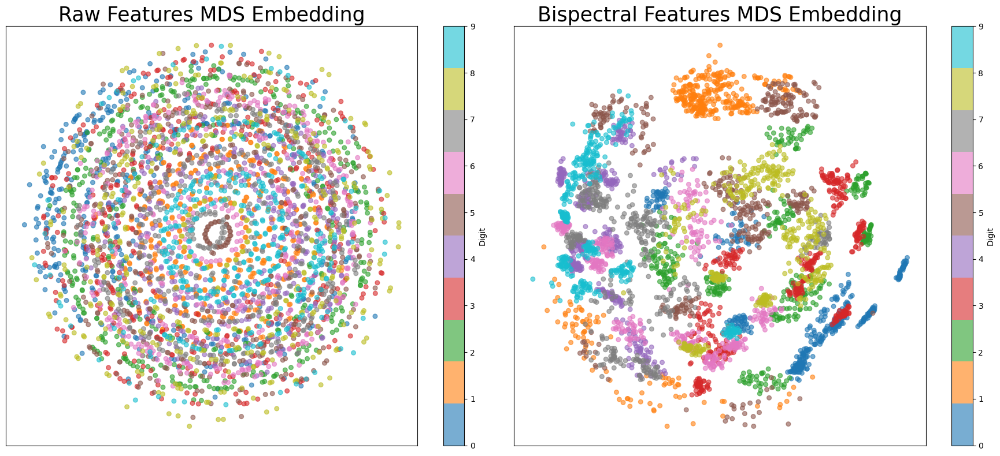

2


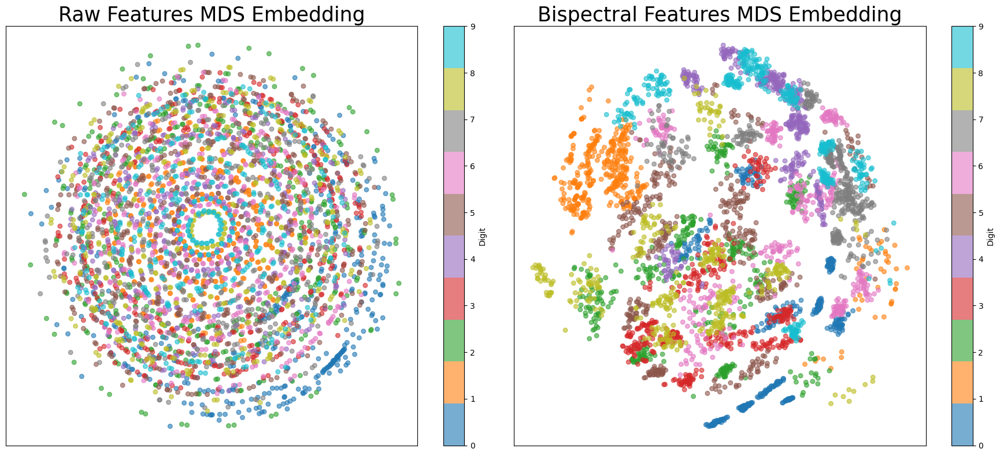

4


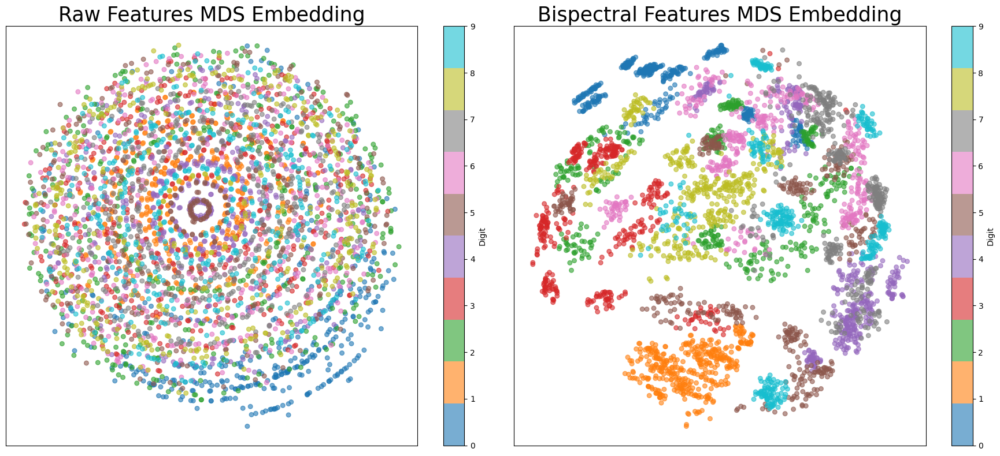

6


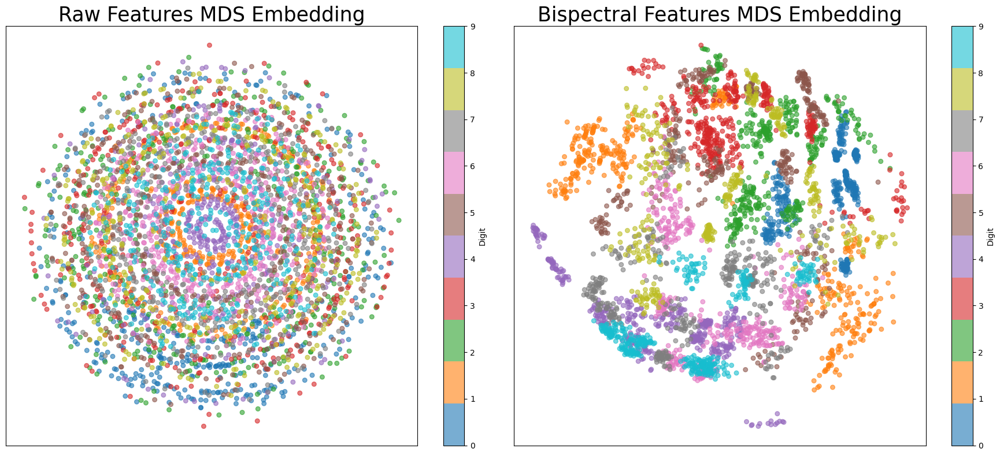

8


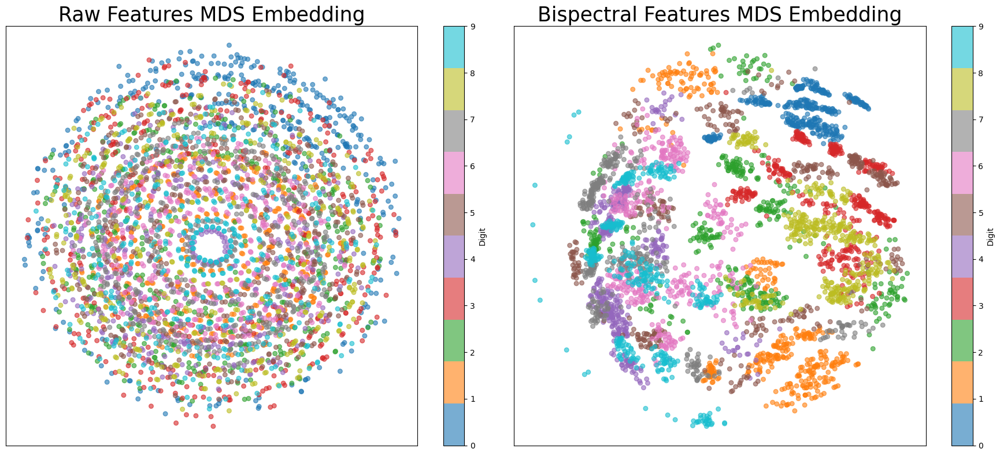

In [30]:
photo_path = str(Path.cwd() / "experiment_photos/10digitsmds")

for seed_idx, seed in enumerate(seeds):
    print(seed)
    fig, axs = plt.subplots(1, 2, figsize=(18, 8))

    scatter_raw = axs[0].scatter(
        embedding_raw_10_digits[seed_idx][:, 0],   # x
        embedding_raw_10_digits[seed_idx][:, 1],   # y
        c=labels_10,                               # colour by digit 0-9
        cmap='tab10',
        s=30,                                      # reduced dot size
        alpha=0.6                                  # added transparency
    )
    axs[0].set_title(f"Raw Features MDS Embedding", fontsize=25)
    axs[0].set_xticks([]);  axs[0].set_yticks([])
    plt.colorbar(scatter_raw, ax=axs[0], label="Digit")

    scatter_bis = axs[1].scatter(
        embedding_bispec_10_digits[seed_idx][:, 0],
        embedding_bispec_10_digits[seed_idx][:, 1],
        c=labels_10,
        cmap='tab10',
        s=30,                                      # reduced dot size
        alpha=0.6                                  # added transparency
    )
    axs[1].set_title(f"Bispectral Features MDS Embedding", fontsize=25)
    axs[1].set_xticks([]);  axs[1].set_yticks([])
    plt.colorbar(scatter_bis, ax=axs[1], label="Digit")

    plt.tight_layout()
    save_path = os.path.join(photo_path, f"10_digits_angle9_mds_embedding_seed_{seed}.png")
    plt.savefig(str(save_path))
    plt.show()

Avg same-class distance (Raw):       7.911 ± 0.092
Avg same-class distance (Bispectrum): 0.561 ± 0.018


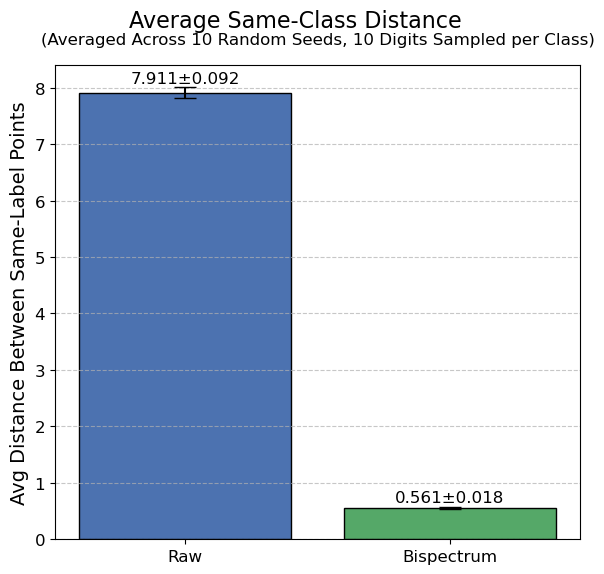

In [31]:
# — compute avg same-class distance across runs —
intra_raw_10_digits = [avg_same_class_distance(e, labels_10) for e in embedding_raw_10_digits]
intra_bis_10_digits = [avg_same_class_distance(e, labels_10) for e in embedding_bispec_10_digits]

mean_raw_10, std_raw_10 = np.mean(intra_raw_10_digits), np.std(intra_raw_10_digits)
mean_bis_10, std_bis_10 = np.mean(intra_bis_10_digits), np.std(intra_bis_10_digits)

# — print & plot —
print(f"Avg same-class distance (Raw):       {mean_raw_10:.3f} ± {std_raw_10:.3f}")
print(f"Avg same-class distance (Bispectrum): {mean_bis_10:.3f} ± {std_bis_10:.3f}")

fig, ax = plt.subplots(figsize=(6, 6))
bars = ax.bar(
    ['Raw', 'Bispectrum'],
    [mean_raw_10, mean_bis_10],
    yerr=[std_raw_10, std_bis_10],
    capsize=8,
    color=['#4C72B0', '#55A868'],
    edgecolor='black'
)
for bar, m, s in zip(bars, [mean_raw_10, mean_bis_10], [std_raw_10, std_bis_10]):
    ax.text(bar.get_x() + bar.get_width()/2,
            m + s + 0.02,
            f"{m:.3f}±{s:.3f}",
            ha='center', va='bottom', fontsize=12)

ax.set_ylabel("Avg Distance Between Same-Label Points", fontsize=14)
fig.suptitle("Average Same-Class Distance", fontsize=16, y=0.95)
ax.set_title("(Averaged Across 10 Random Seeds, 10 Digits Sampled per Class)", fontsize=12, pad=15)
ax.tick_params(labelsize=12)
ax.yaxis.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Finding Average Class Distance

## Functions

In [21]:
def _flatten2d(seq, *, dtype=np.float32) -> np.ndarray:
    if len(seq) > 0 and isinstance(seq[0], torch.Tensor):
        try:
            T = torch.stack([x if x.is_cpu else x.cpu() for x in seq], dim=0)
            A = T.detach().cpu().numpy()
            if np.iscomplexobj(A):
                A = np.stack([A.real, A.imag], axis=1)  # [N,2,...]
            return A.reshape(len(seq), -1).astype(dtype, copy=False)
        except Exception:
            pass  

    try:
        A = np.asarray(seq)
        if A.dtype == object:
            raise TypeError
        if np.iscomplexobj(A):
            A = np.stack([A.real, A.imag], axis=1)  # [N,2,...]
        return A.reshape(len(seq), -1).astype(dtype, copy=False)
    except Exception:
        # Fallback loop
        rows = []
        append = rows.append
        for x in seq:
            a = x.detach().cpu().numpy() if isinstance(x, torch.Tensor) else np.asarray(x)
            if np.iscomplexobj(a):
                a = np.stack([a.real, a.imag], axis=0)
            append(a.reshape(-1).astype(dtype, copy=False))
        return np.vstack(rows)


def angle_matrix_per_digit(
    prep_or_emb,
    labels=None,
    angles=None,
    *,
    which: str = "bs",
    metric: str = "euclidean",
    reducer="mean",  # "mean", "median", or callable
    dtype=np.float32
):
    if isinstance(prep_or_emb, dict) and labels is None and angles is None:
        emb_seq = prep_or_emb[which]
        labels  = np.asarray(prep_or_emb["ys"])
        angles  = np.asarray(prep_or_emb["angles"])
    else:
        emb_seq = prep_or_emb
        labels  = np.asarray(labels)
        angles  = np.asarray(angles)

    labels = labels.ravel()
    angles = angles.ravel()

    X      = _flatten2d(emb_seq, dtype=dtype)
    angs   = np.unique(angles)
    digits = np.unique(labels)

    if callable(reducer):
        reducer_fn = reducer
    else:
        reducer_fn = np.median if str(reducer).lower() == "median" else np.mean

    per_digit = {}
    A = angs.size

    for d in digits:
        idx_d = np.flatnonzero(labels == d)
        if idx_d.size == 0:
            per_digit[d] = np.full((A, A), np.nan, dtype=np.float64)
            continue

        Xd    = X[idx_d]
        ang_d = angles[idx_d]

        D = cdist(Xd, Xd, metric=metric)

        angle_idxs = [np.flatnonzero(ang_d == a) for a in angs]

        mat = np.full((A, A), np.nan, dtype=np.float64)

        for i, Ii in enumerate(angle_idxs):
            if Ii.size == 0:
                continue
            for j in range(i, A):
                Ij = angle_idxs[j]
                if Ij.size == 0:
                    continue

                block = D[np.ix_(Ii, Ij)]

                if i == j:
                    n = block.shape[0]
                    if n < 2:
                        continue
                    s = block.sum(dtype=np.float64) - np.trace(block, dtype=np.float64)
                    m = s / (n * n - n)
                else:
                    m = block.mean(dtype=np.float64)

                if reducer_fn is np.median and i != j:
                    m = float(np.median(block))
                elif reducer_fn is np.median and i == j:
                    iu = np.triu_indices(block.shape[0], k=1)
                    m = float(np.median(block[iu]))
                else:
                    m = float(m)

                mat[i, j] = mat[j, i] = m

        per_digit[d] = mat

    return per_digit, angs

In [22]:
def class_distance_confusion(
    emb_or_prep,
    labels=None,
    *,
    which="bs",                   # if a dict is passed, use this key for embeddings
    metric="euclidean",           # any metric accepted by scipy.spatial.distance.cdist
    metric_kwargs=None,           # extra kwargs for the metric (e.g., {"p": 3} for minkowski)
    reducer="mean",               # "mean", "median", or a callable(vector)->scalar
    dtype=np.float64
):
    # Unpack dict pattern like your other helpers
    if isinstance(emb_or_prep, dict) and labels is None:
        X_seq  = emb_or_prep[which]
        labels = np.asarray(emb_or_prep["ys"])
    else:
        X_seq  = emb_or_prep
        labels = np.asarray(labels)

    labels = labels.ravel()

    X = _flatten2d(X_seq)
   
    classes = np.unique(labels)
    C = len(classes)
    metric_kwargs = metric_kwargs or {}

    # Compute full pairwise distance matrix once with SciPy
    D = cdist(X, X, metric=metric, **metric_kwargs)

    # Reducer
    if callable(reducer):
        reduce_fn = reducer
    else:
        reduce_fn = np.median if str(reducer).lower() == "median" else np.mean

    M = np.full((C, C), np.nan, dtype=dtype)
    idx_by_class = [np.flatnonzero(labels == c) for c in classes]

    for i in range(C):
        Ii = idx_by_class[i]
        if Ii.size >= 2:
            sub = D[np.ix_(Ii, Ii)]
            iu = np.triu_indices(Ii.size, k=1)  # unique unordered pairs
            M[i, i] = float(reduce_fn(sub[iu]))

        for j in range(i + 1, C):
            Ij = idx_by_class[j]
            if Ij.size == 0 or Ii.size == 0:
                continue
            sub = D[np.ix_(Ii, Ij)].ravel()
            M[i, j] = M[j, i] = float(reduce_fn(sub))

    return M, classes

In [23]:
# for angles
def plot_distance_heatmap(dist_mat, classes, title, save_path = None):
    dist_mat = np.asarray(dist_mat, dtype=float)
    n = dist_mat.shape[0]

    mask = np.eye(n, dtype=bool)
    masked = np.ma.array(dist_mat, mask=mask)
    
    finite_offdiag = masked.compressed() 
    vmin = np.nanmin(finite_offdiag) if finite_offdiag.size else None
    vmax = np.nanmax(finite_offdiag) if finite_offdiag.size else None

    fig, ax = plt.subplots(figsize=(8, 7))
    cmap = plt.get_cmap("viridis").copy()
    cmap.set_bad("white") 

    im = ax.imshow(masked, cmap=cmap, vmin=vmin, vmax=vmax)

    ax.set_xticks(range(len(classes)))
    ax.set_yticks(range(len(classes)))
    ax.set_xticklabels(classes, rotation=45,ha="right")
    ax.set_yticklabels(classes)
    ax.set_xlabel("Rotation Angle (°)")
    ax.set_ylabel("Rotation Angle (°)")
    ax.set_title(title)
    overall = np.nanmean(finite_offdiag) if finite_offdiag.size else np.nan
    for i in range(n):
        for j in range(n):
            if i == j:
                continue  # skip diagonal
            v = dist_mat[i, j]
            if np.isnan(v):
                continue
            ax.text(
                j, i, f"{v:.2f}",
                ha="center", va="center",
                color=("white" if (not np.isnan(overall) and v < overall) else "black"),
                fontsize=6,
            )

    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04, label="Mean distance")
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(save_path)
    plt.show()

In [24]:
# for classes 

def plot_distance_heatmap2(dist_mat, classes, title=None, *,
                           xlabel="Class", ylabel="Class",
                           figsize=(8, 7), cmap="viridis", save_path=None):
    dist_mat = np.asarray(dist_mat, dtype=float)
    n = dist_mat.shape[0]
    assert dist_mat.ndim == 2 and dist_mat.shape[1] == n, "dist_mat must be square"
    assert len(classes) == n, "classes length must match dist_mat size"

    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(dist_mat, cmap=cmap, aspect="equal")

    ax.set_xticks(np.arange(n))
    ax.set_yticks(np.arange(n))
    ax.set_xticklabels(classes)
    ax.set_yticklabels(classes)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    if title:
        ax.set_title(title)

    # Mean across ALL finite cells (incl. diagonal) for text color threshold
    finite_mask = np.isfinite(dist_mat)
    overall = float(np.mean(dist_mat[finite_mask])) if finite_mask.any() else np.nan

    # Annotate ALL cells (skip only NaNs/±inf)
    for i in range(n):
        for j in range(n):
            v = dist_mat[i, j]
            if not np.isfinite(v):
                continue
            # viridis is dark at low values, light at high values:
            color = "white" if (np.isfinite(overall) and v < overall) else "black"
            ax.text(j, i, f"{v:.2f}", ha="center", va="center", color=color, fontsize=8)

    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04, label="Mean distance")
    fig.tight_layout()
    if save_path is not None:
        plt.savefig(save_path)
    return fig, ax

## Generating Plots (For 10 Representatives for each Digit)

done
done w euclidean


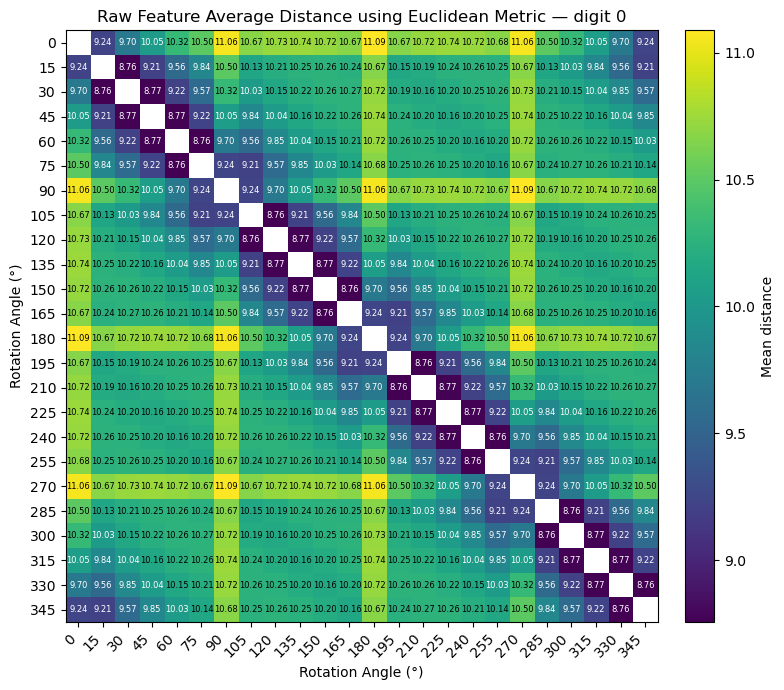

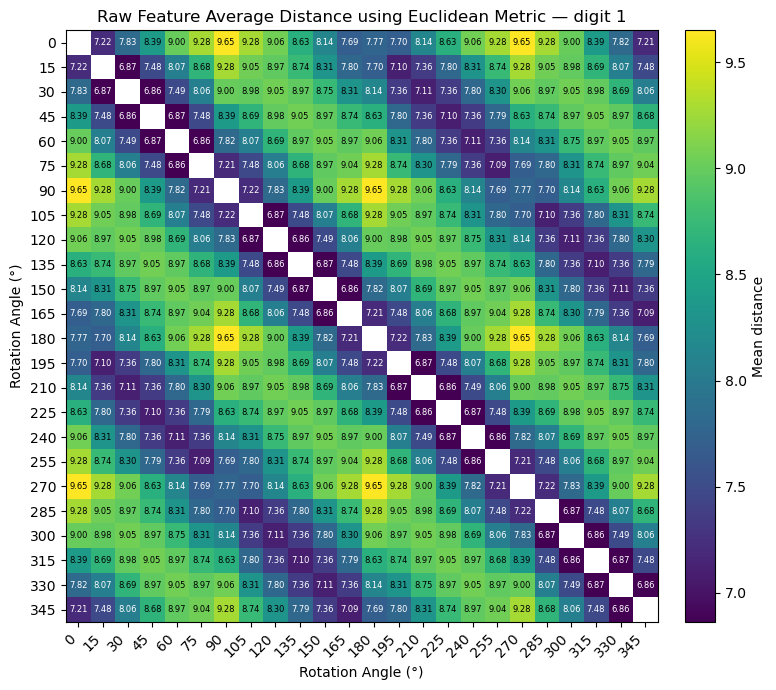

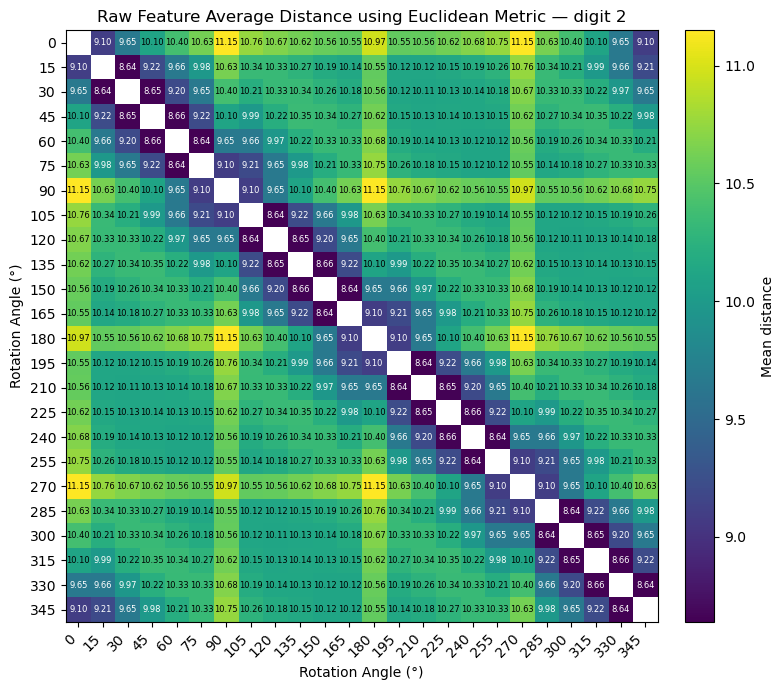

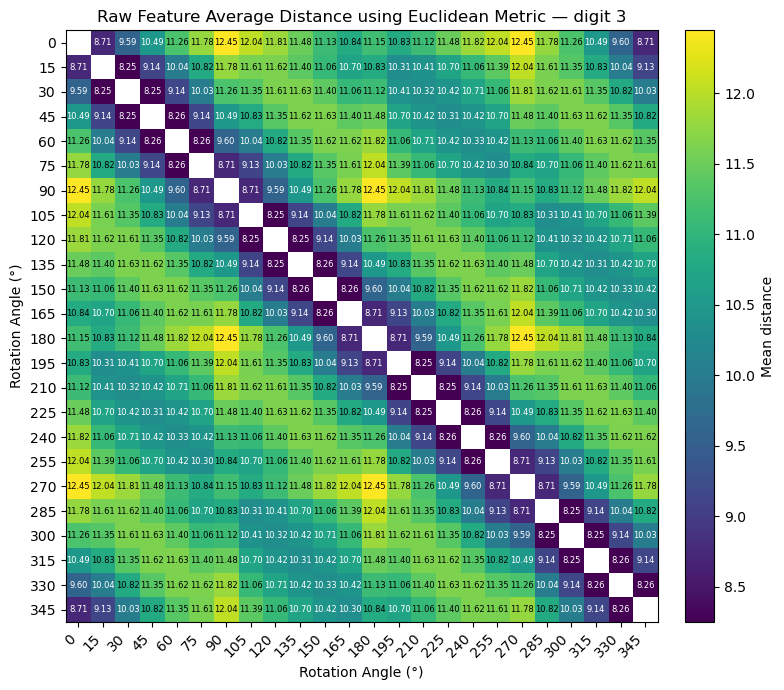

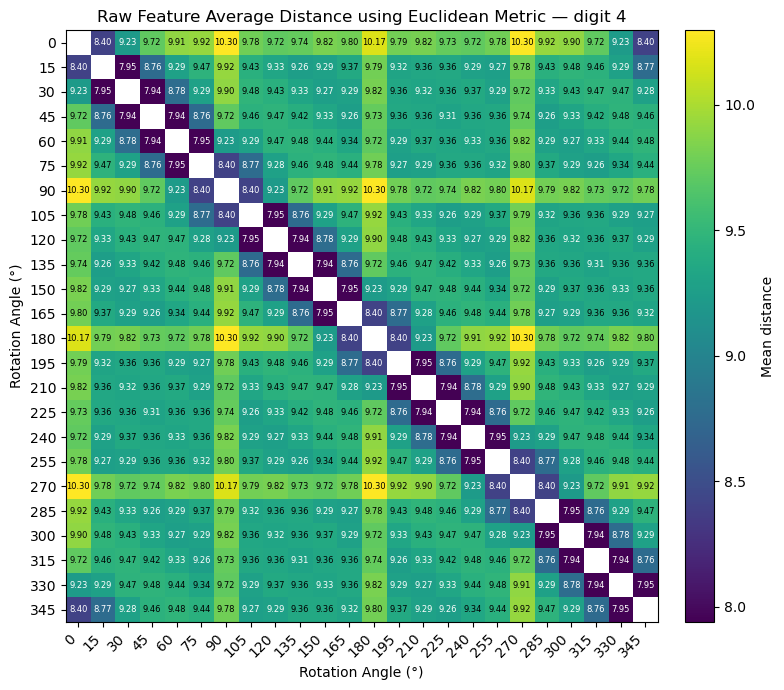

...

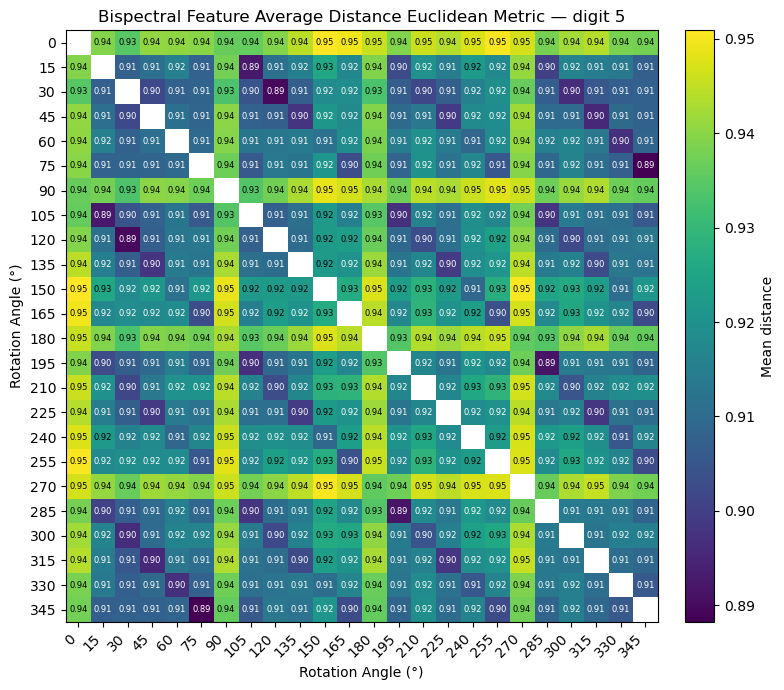

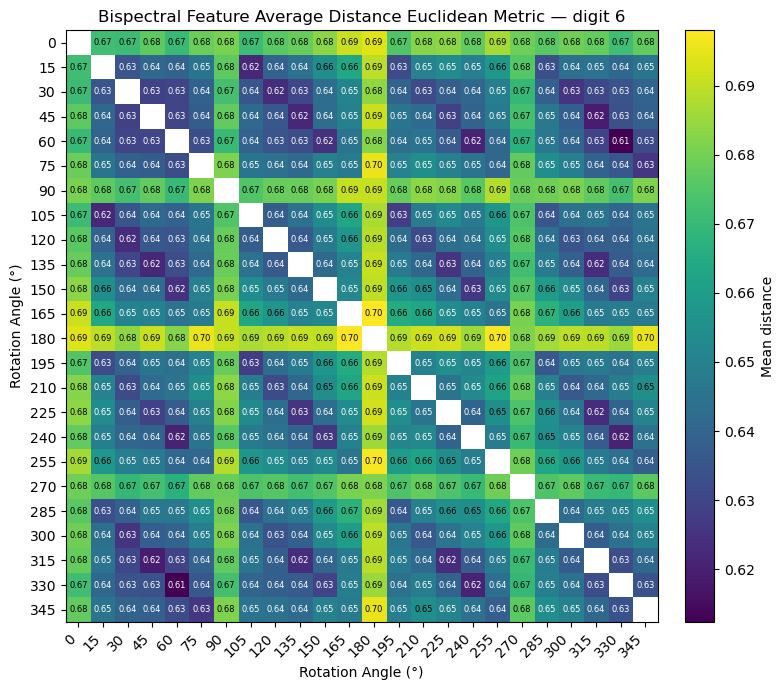

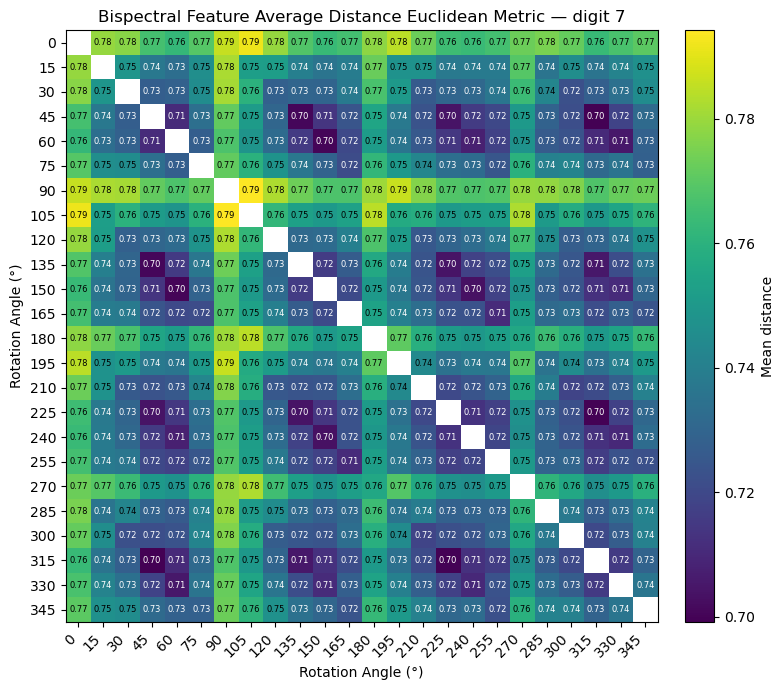

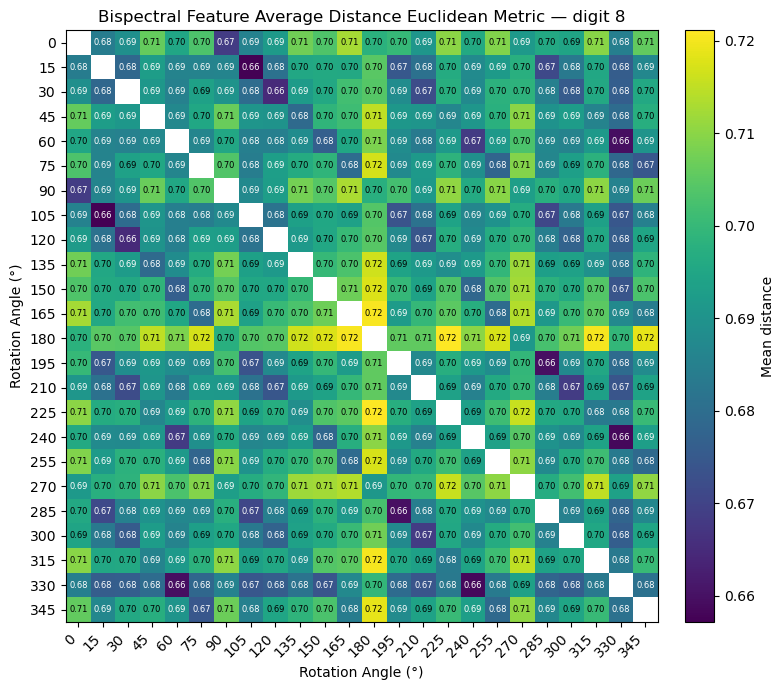

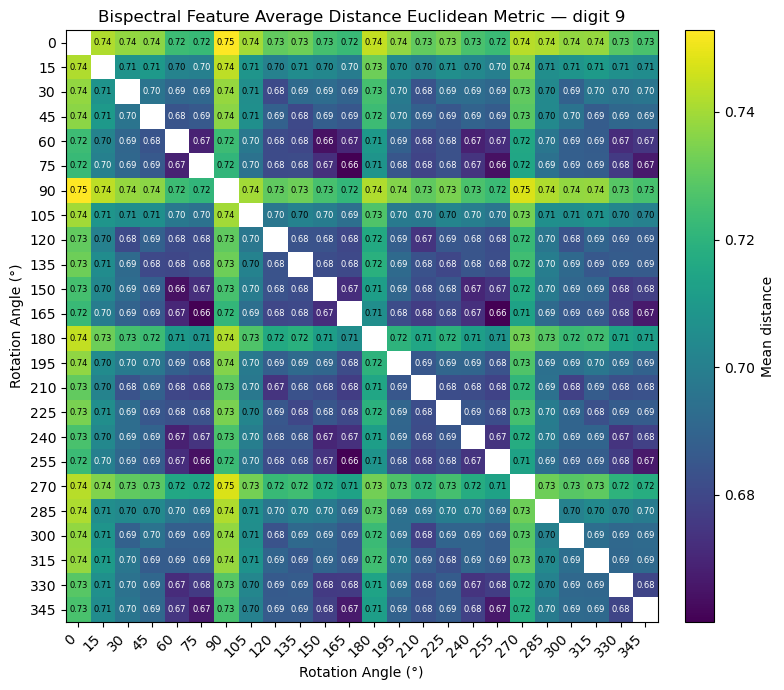

done
done w cityblock


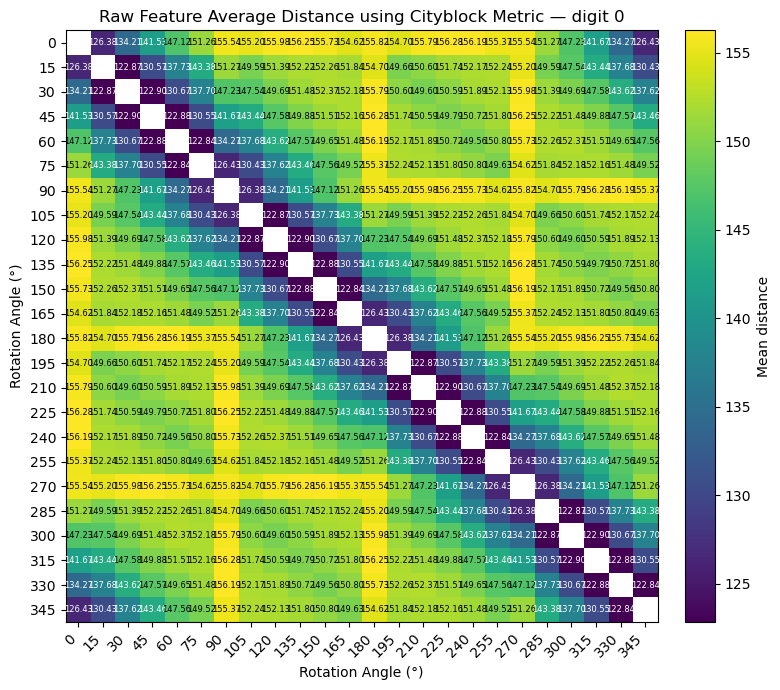

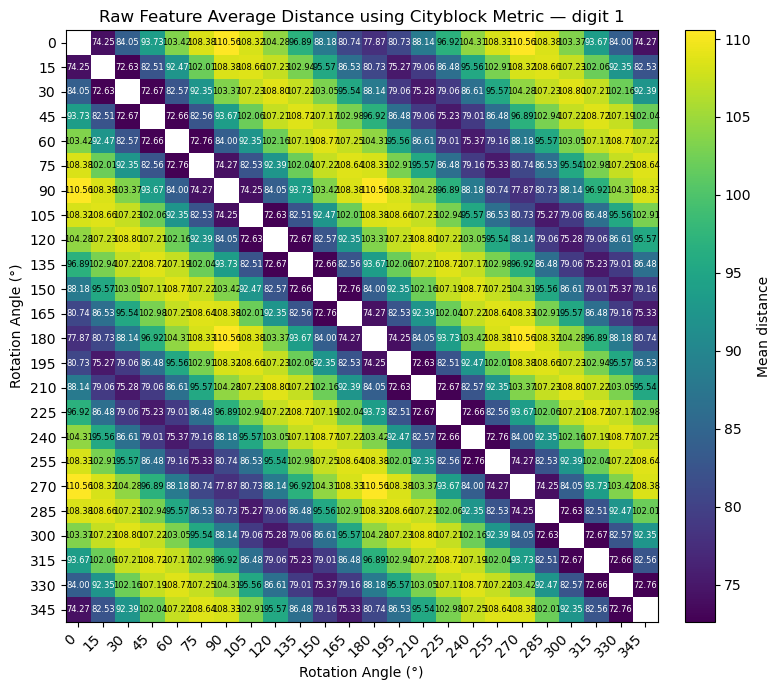

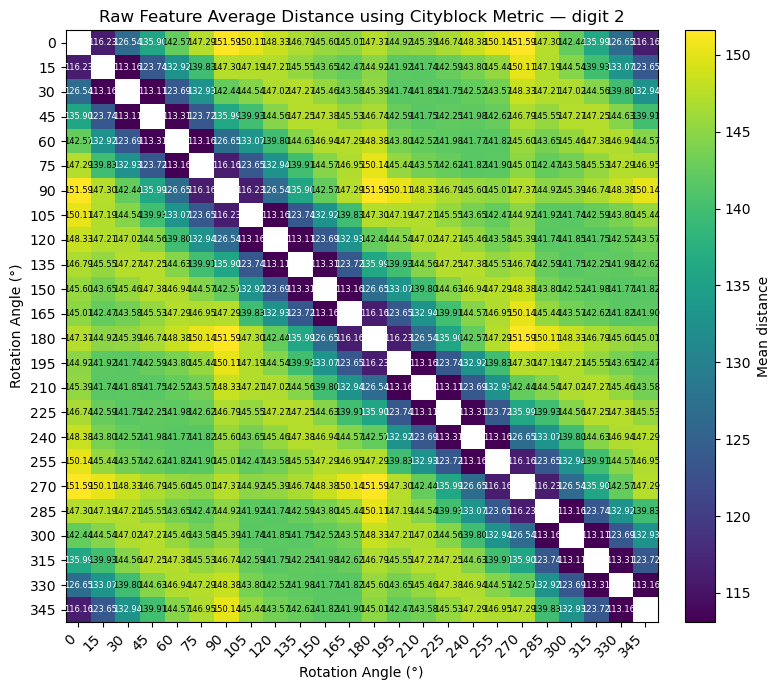

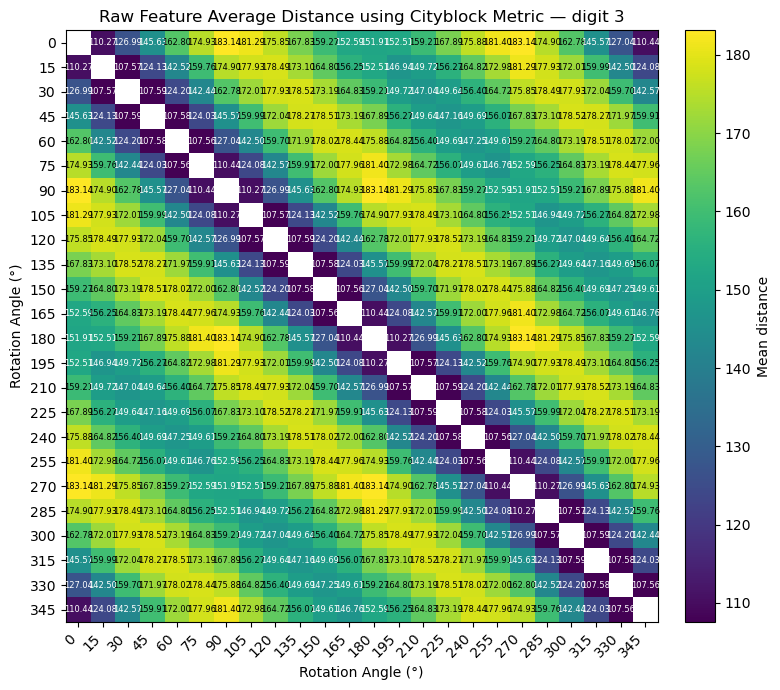

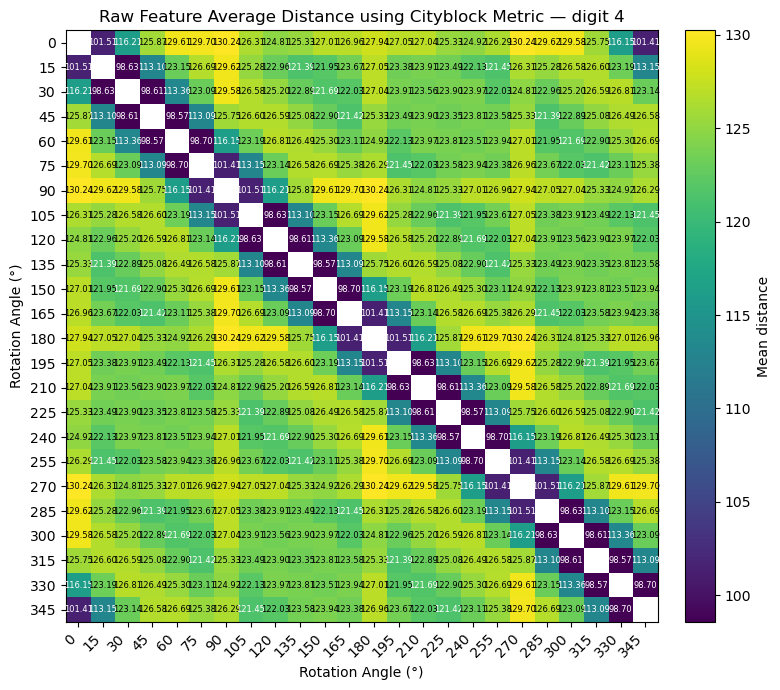

...

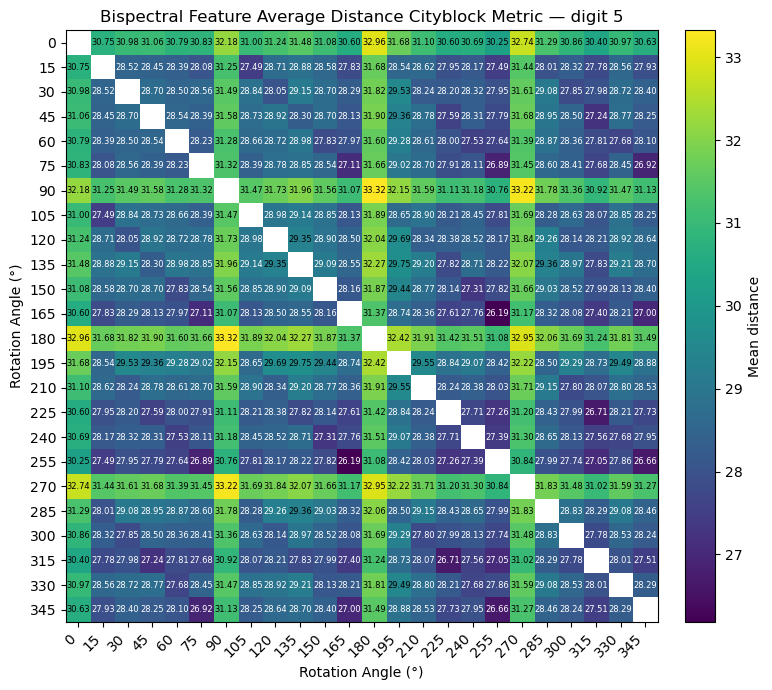

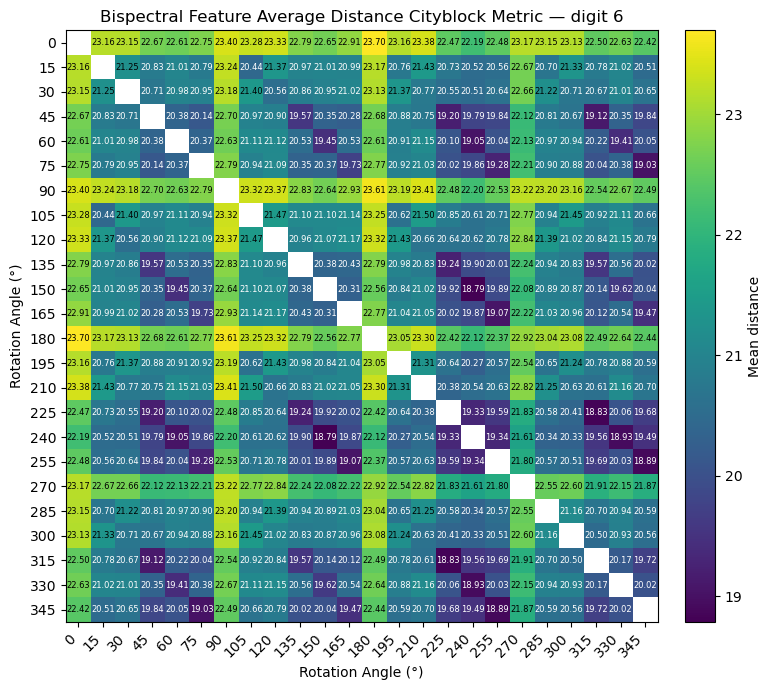

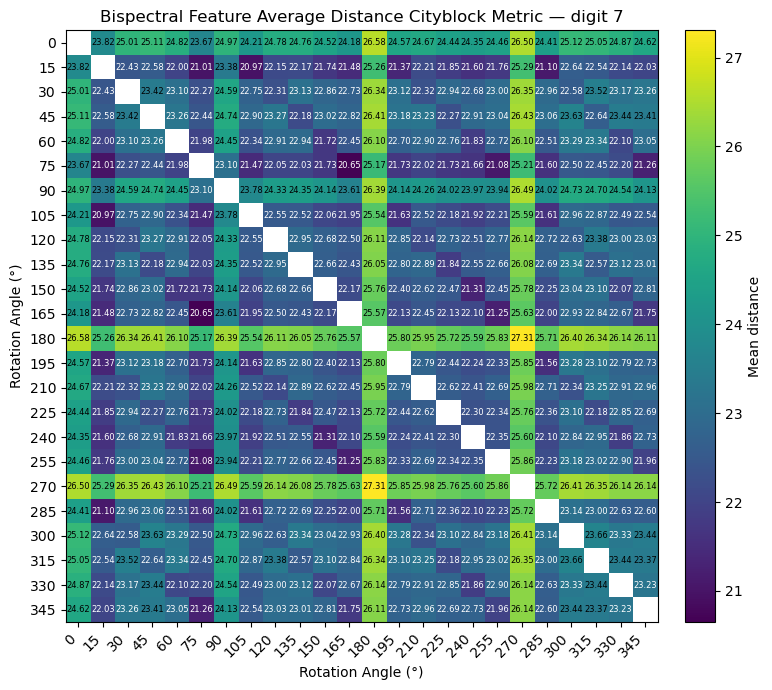

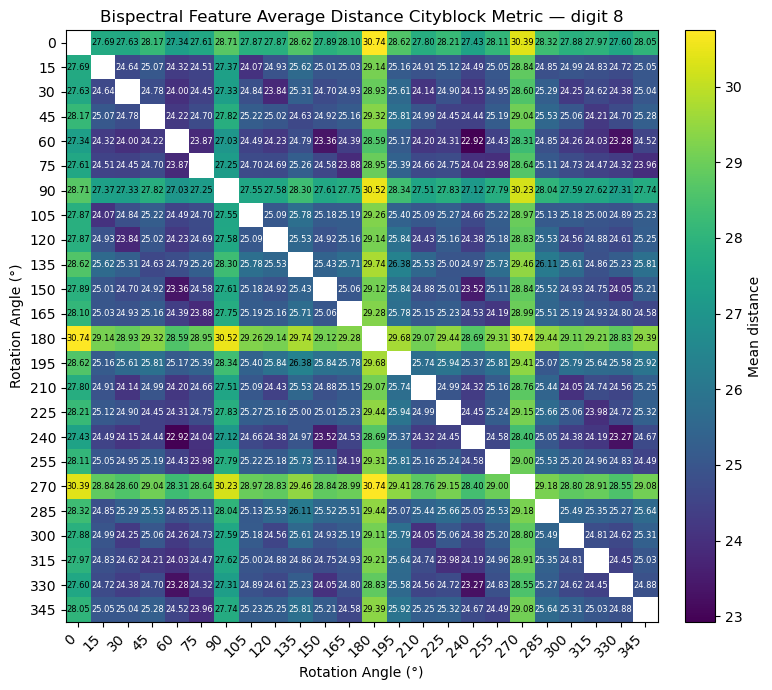

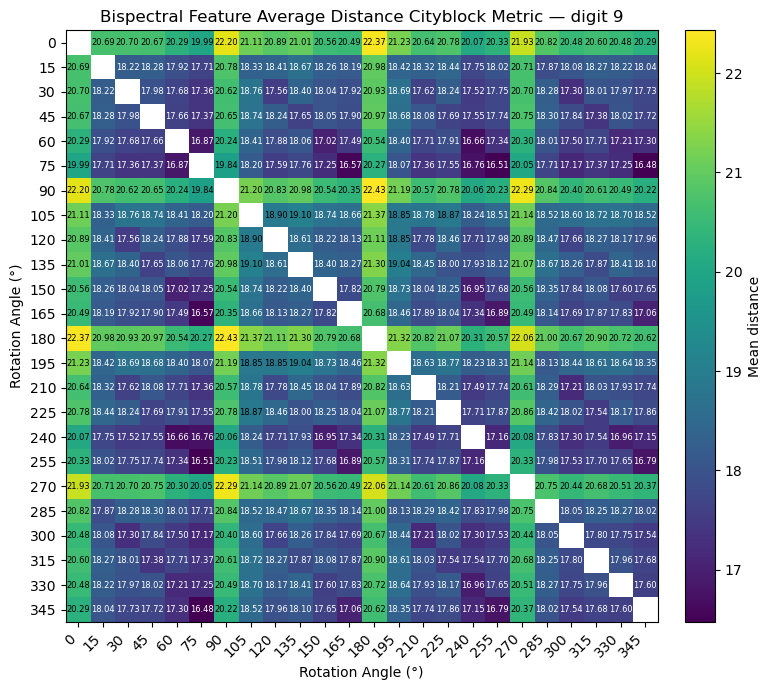

done
done w cosine


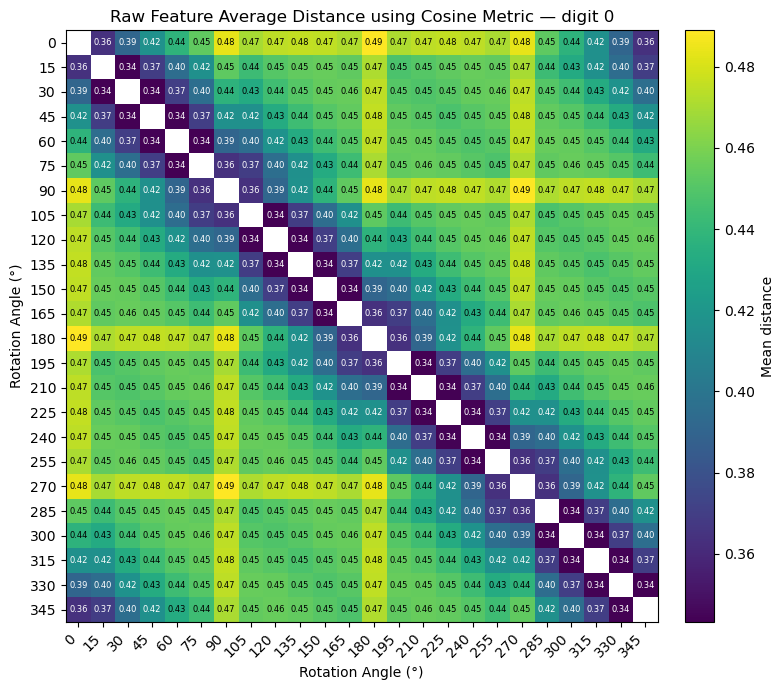

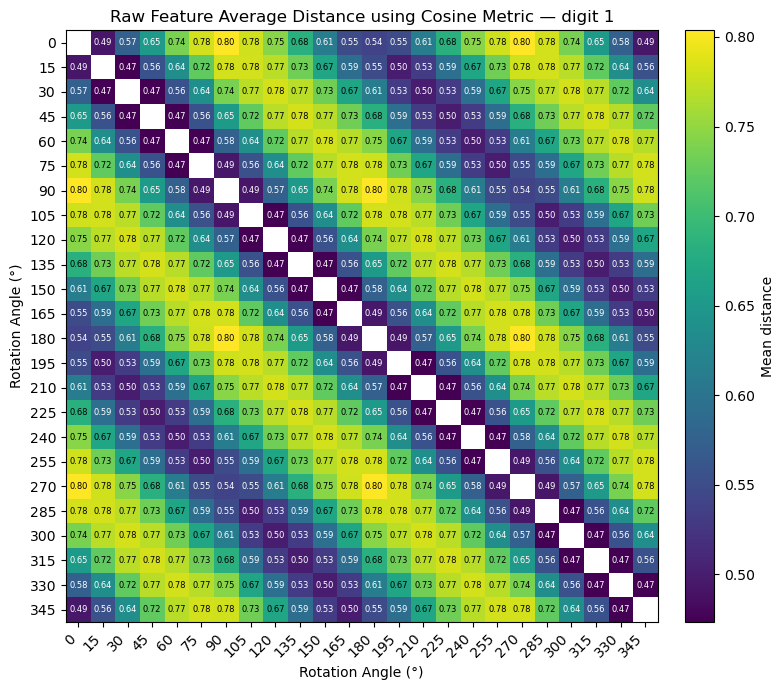

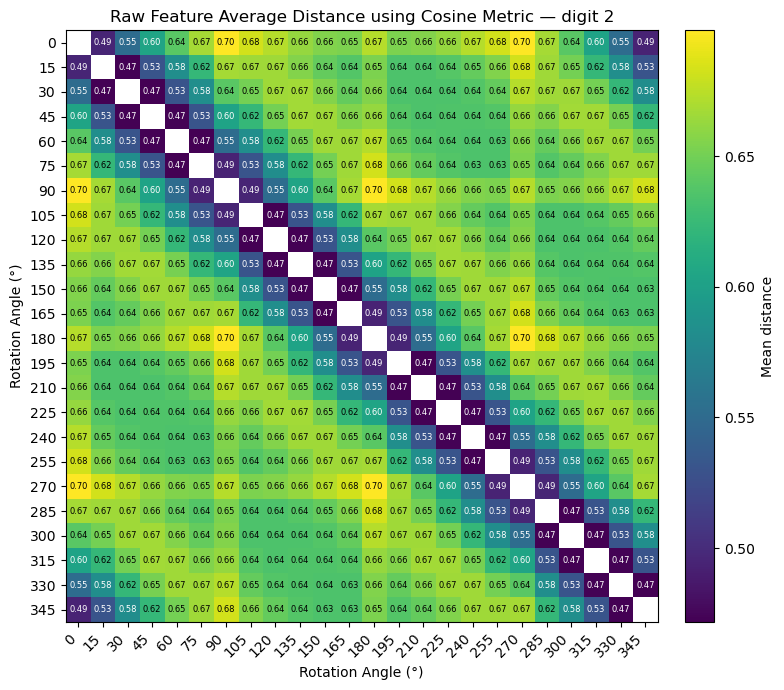

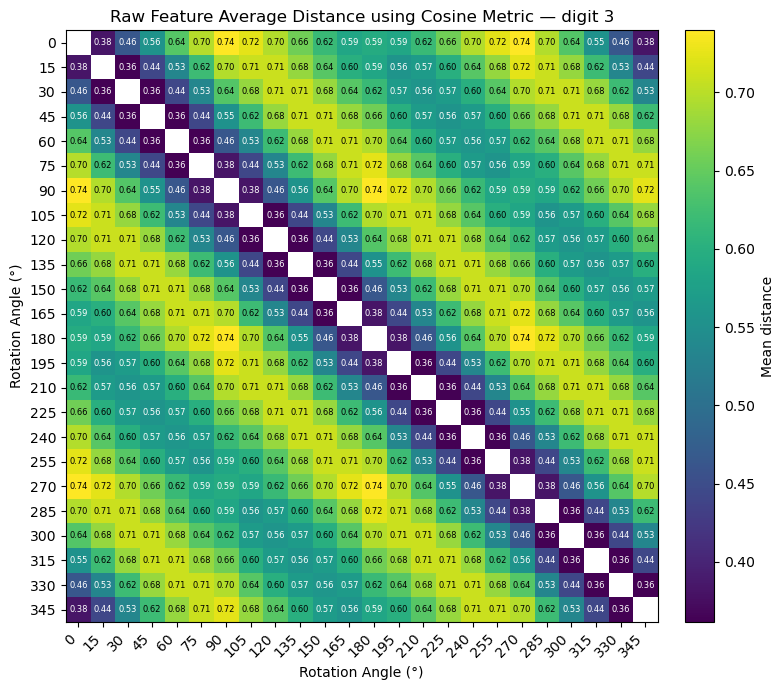

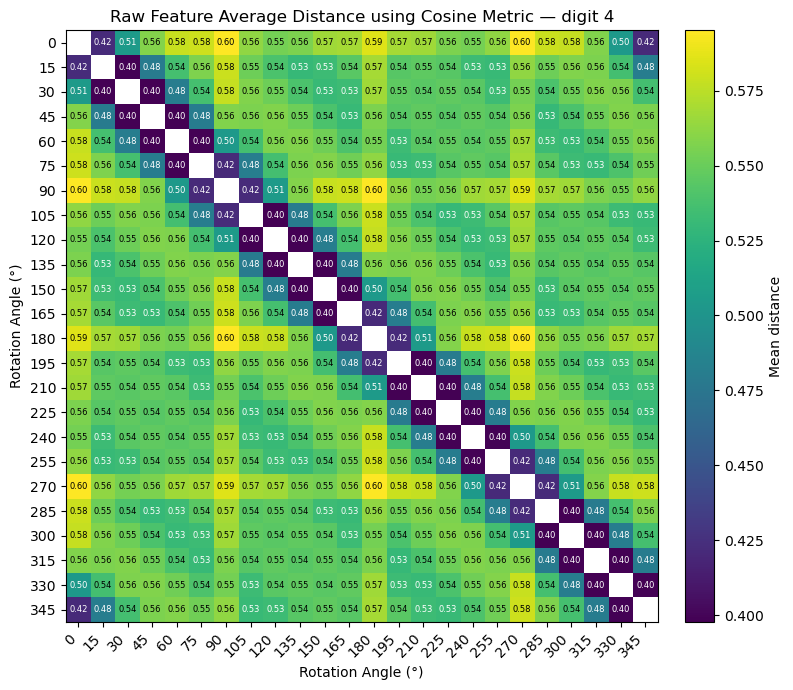

...

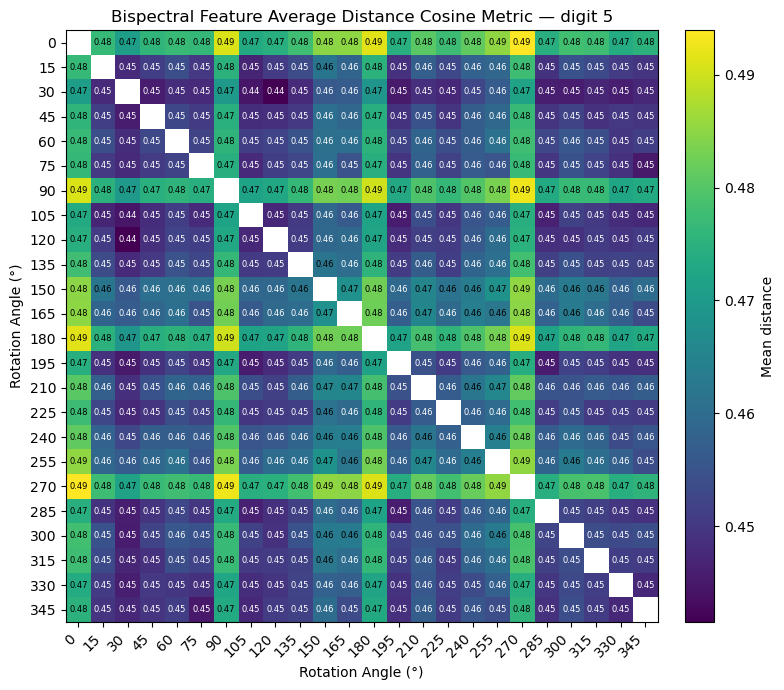

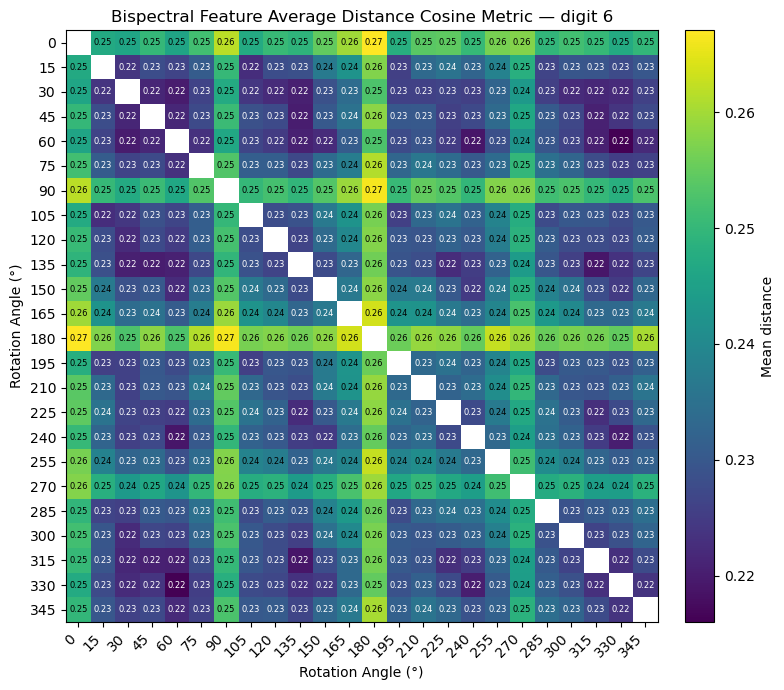

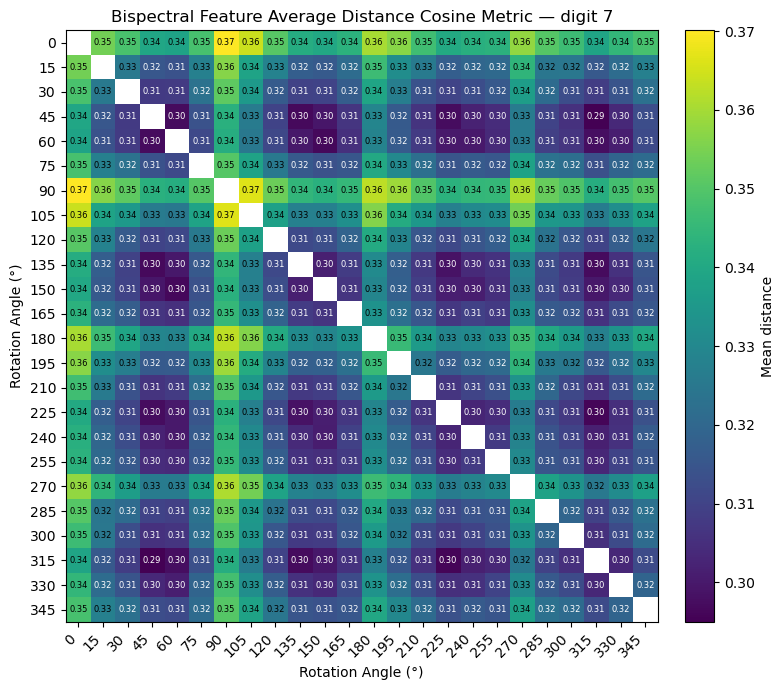

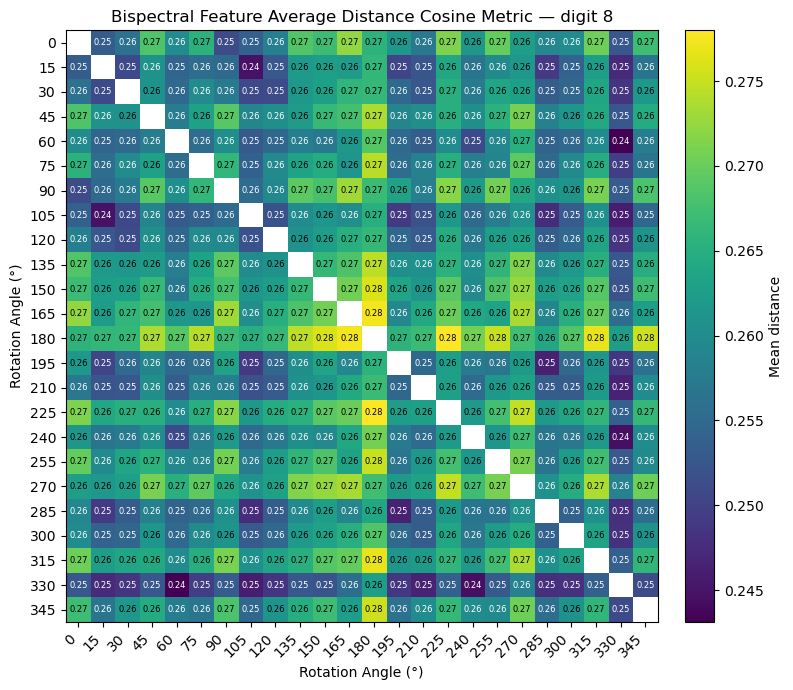

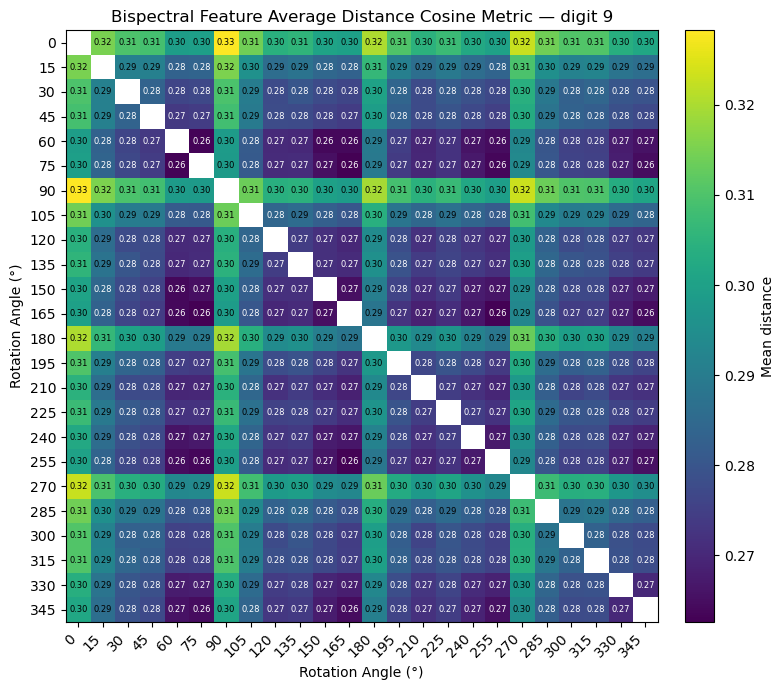

done
done w sqeuclidean


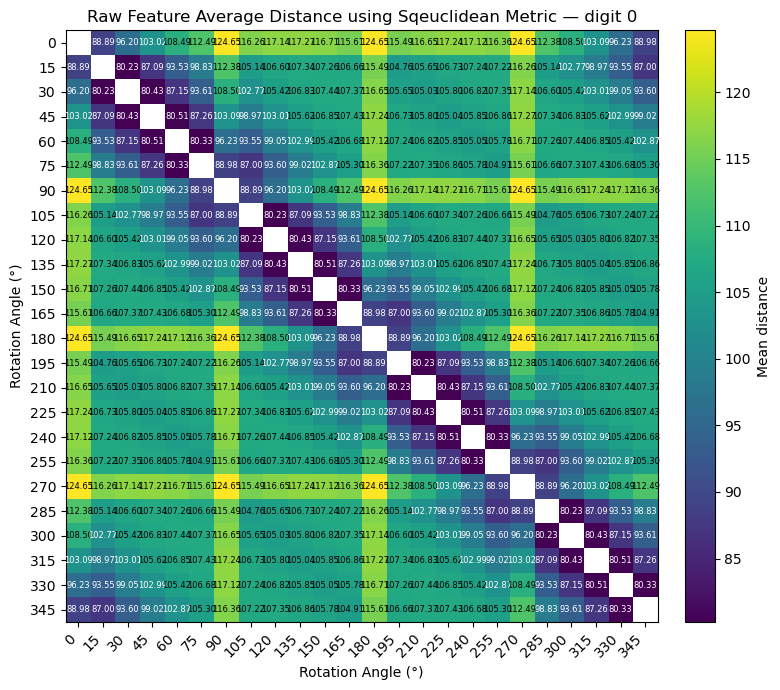

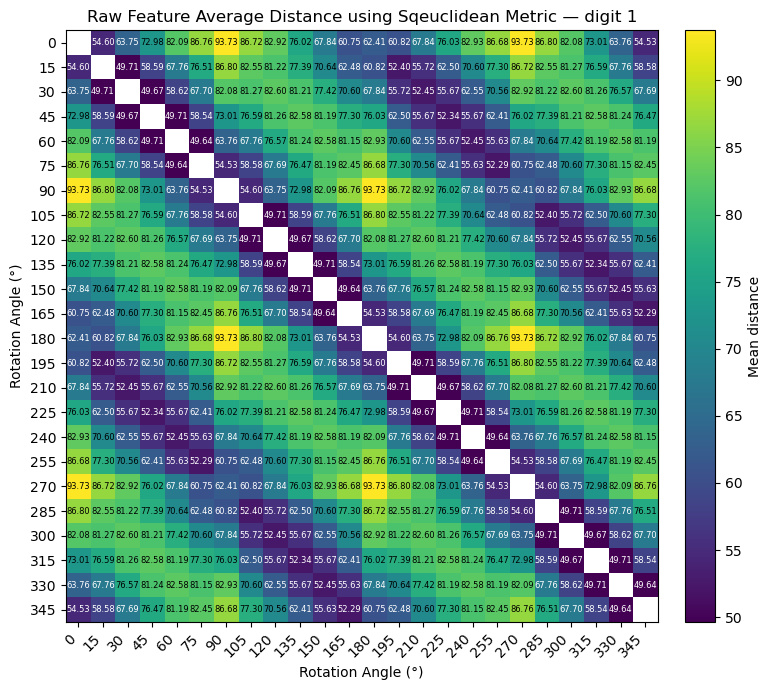

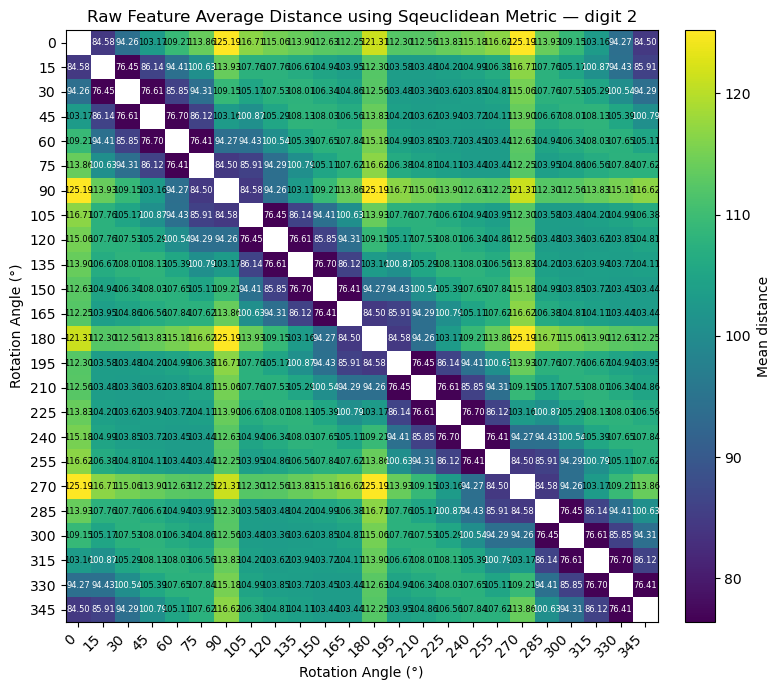

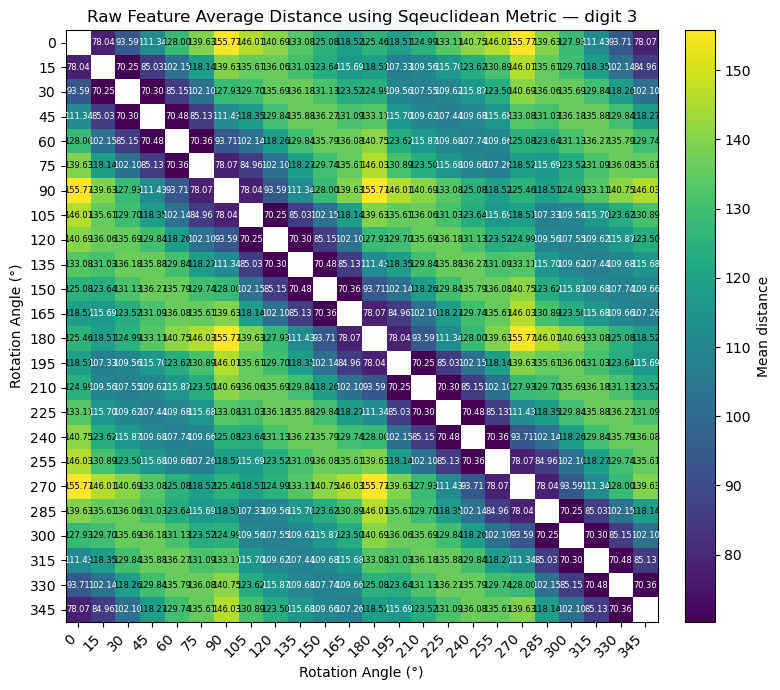

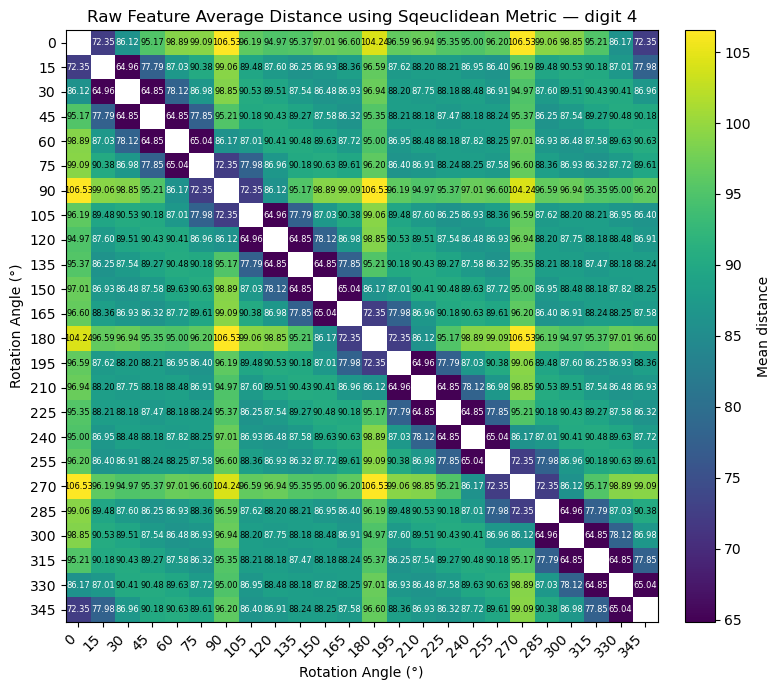

...

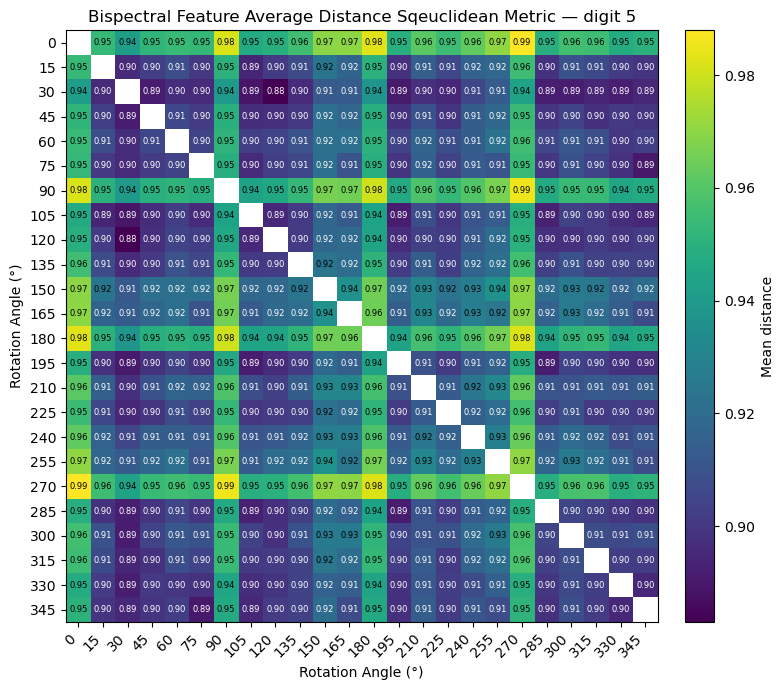

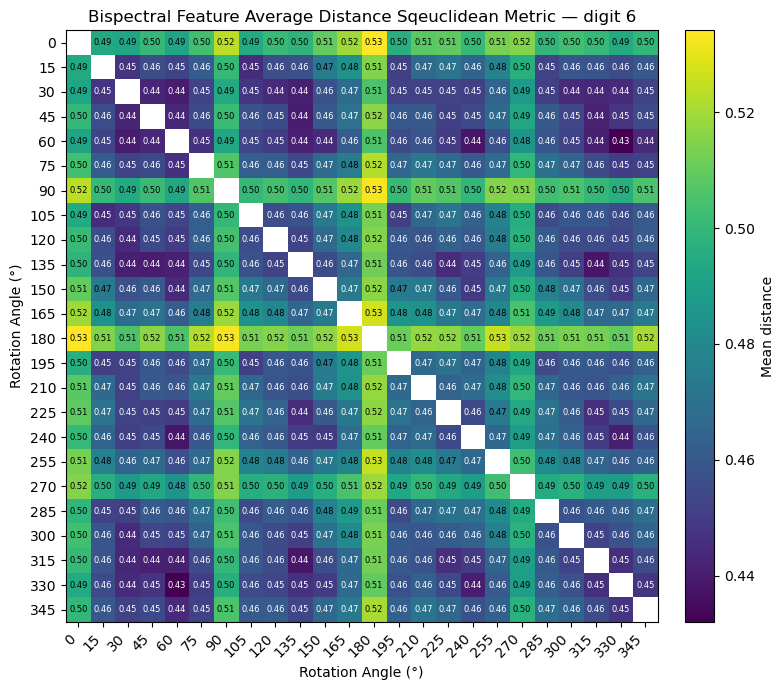

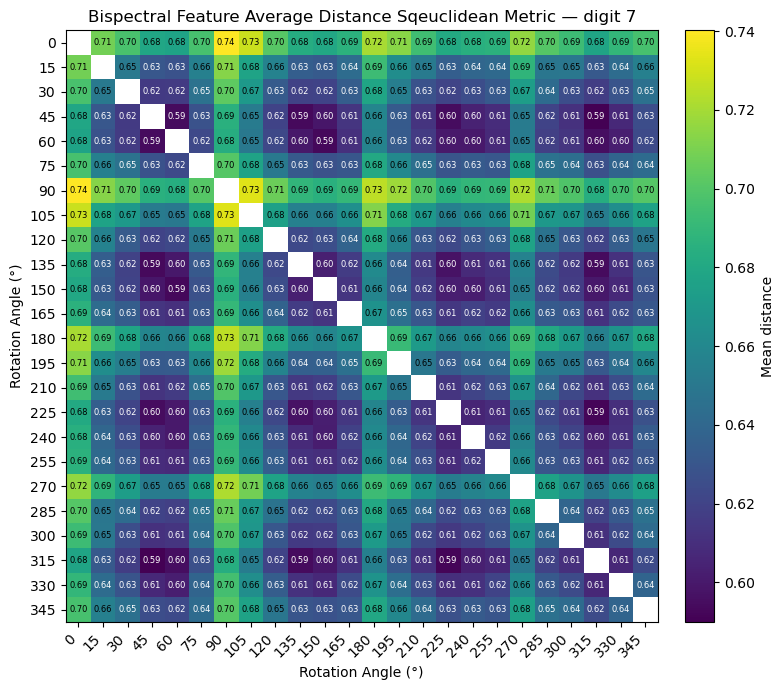

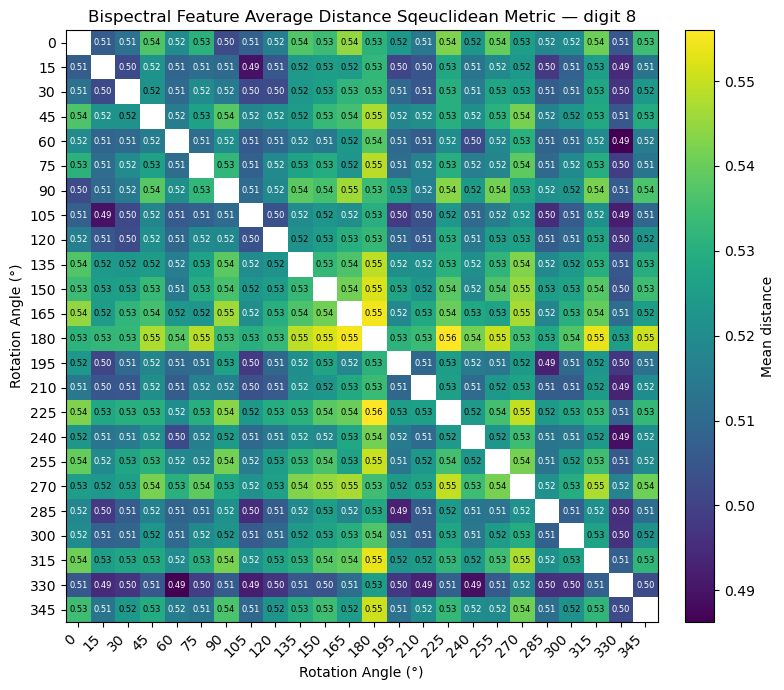

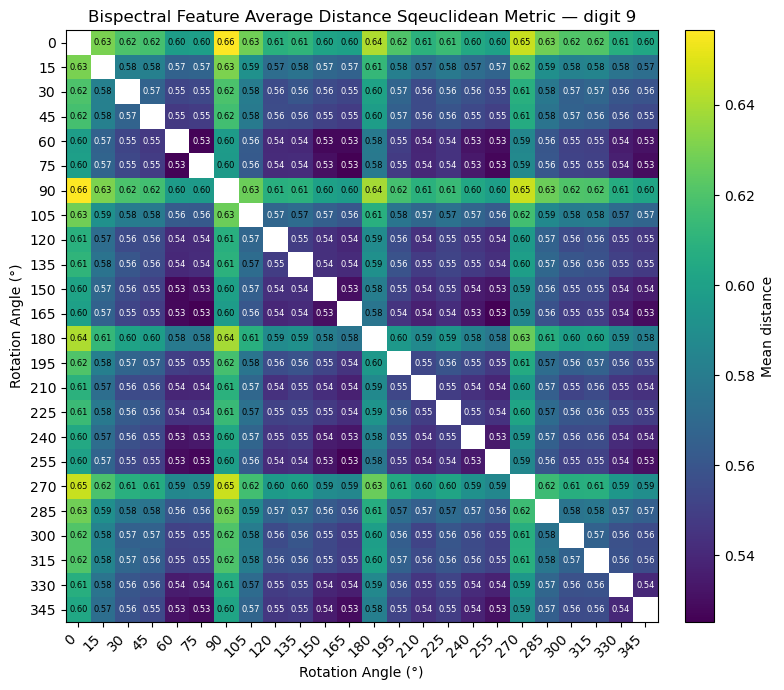

In [25]:
outdir = str(Path.cwd() / "experiment_photos/distance_conf_mats_by_angle_seed8")
prep = prepare_bispec_embed(mnist, angle=15, prototypes_per_digit=10, seed=8)

metrics = ['euclidean', 'cityblock', 'cosine', 'sqeuclidean']

for m in metrics:
    per_digit_xs, angs = angle_matrix_per_digit(prep, which="xs", metric=m)
    print('done')
    per_digit_bs, _ = angle_matrix_per_digit(prep, which="bs", metric=m)
    print(f'done w {m}')
    classes = [str(int(a)) for a in angs]

    for d in sorted(per_digit_bs.keys()):
        # NON-BISPECTRAL (pixel space)
        plot_distance_heatmap(
            per_digit_xs[d],
            classes,
            title=f"Raw Feature Average Distance using {m.capitalize()} Metric — digit {d}",
            save_path=os.path.join(outdir, f"xs_{m}_{d}_cf.png")
        )

    for d in sorted(per_digit_bs.keys()):
        plot_distance_heatmap(
            per_digit_bs[d],
            classes,
            title=f"Bispectral Feature Average Distance {m.capitalize()} Metric — digit {d}",
            save_path=os.path.join(outdir, f"bs_{m}_{d}_cf.png")
        )



## Making Matrices By Digit

In [26]:
prep_9 = prepare_bispec_embed(mnist, angle=9, prototypes_per_digit=10, seed=8)

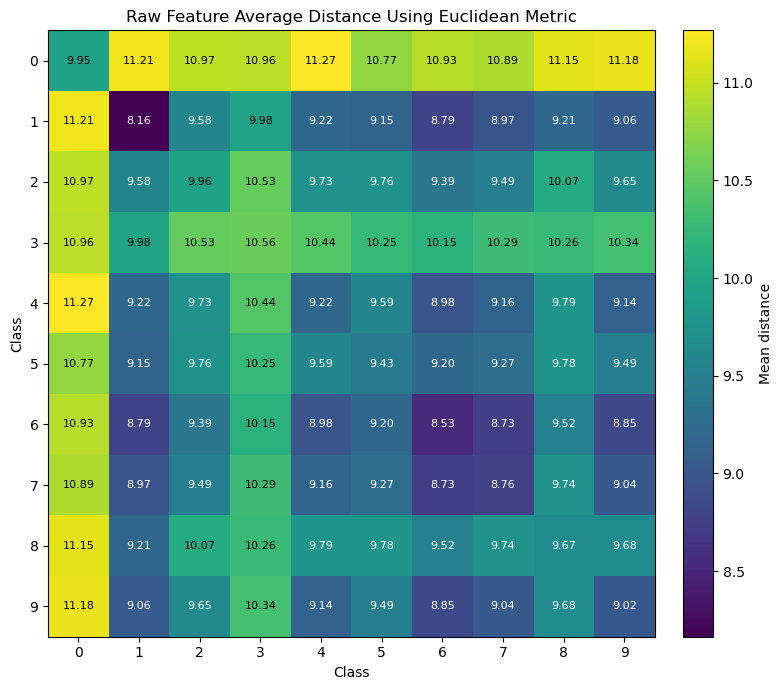

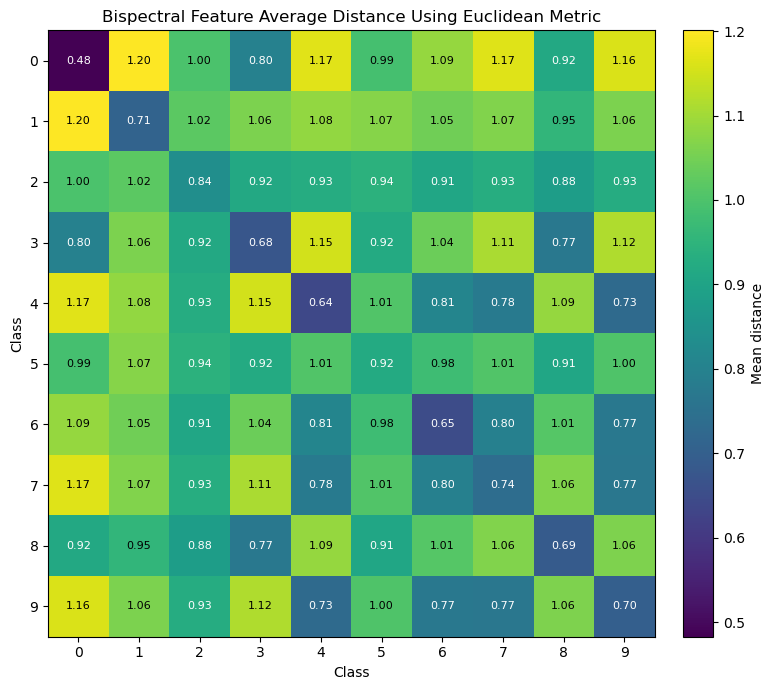

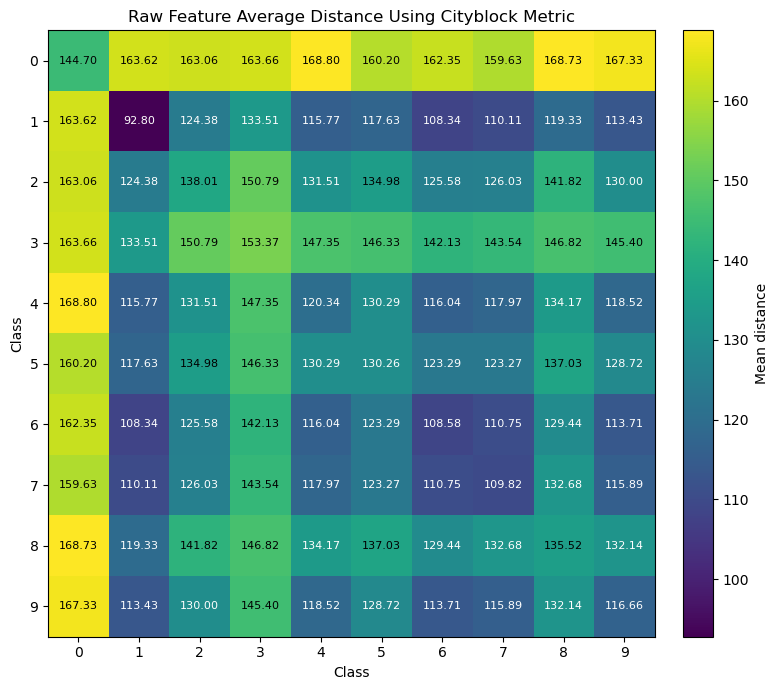

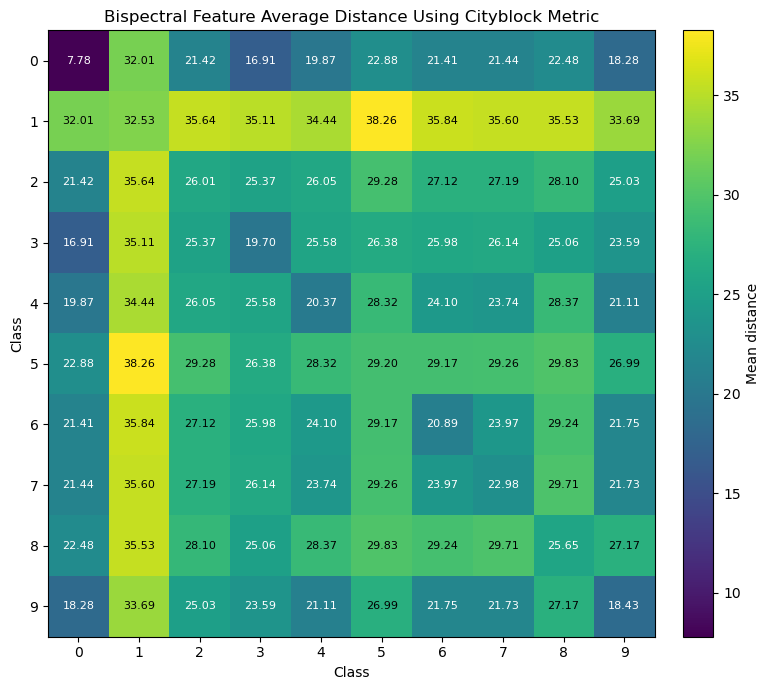

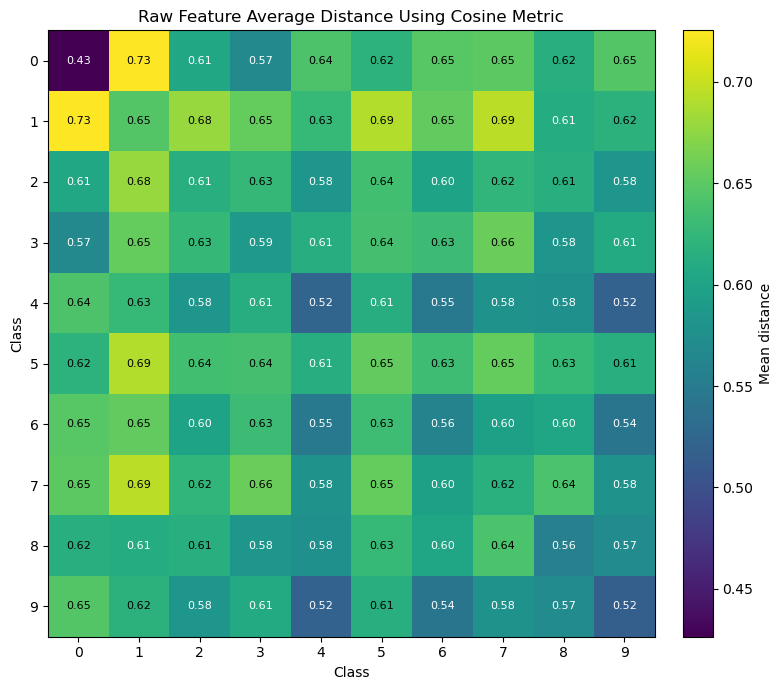

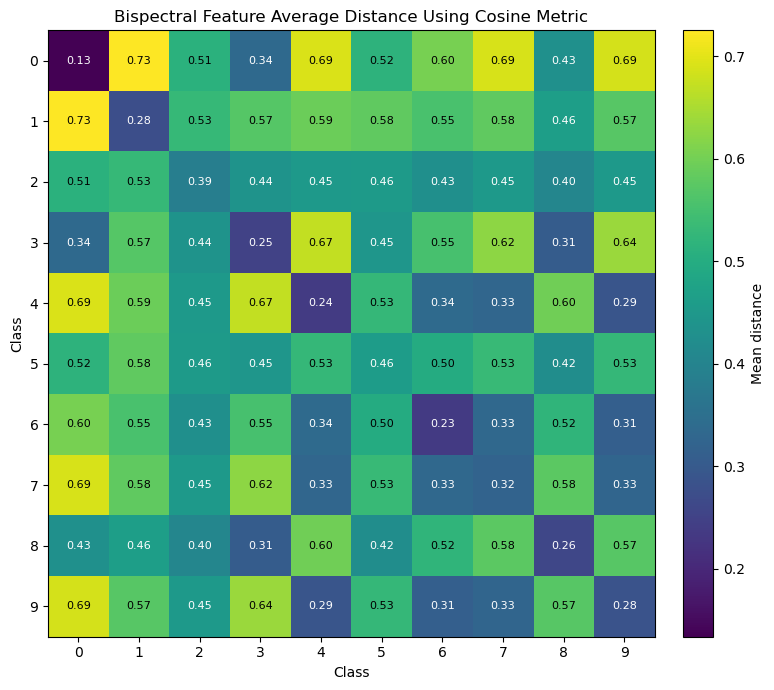

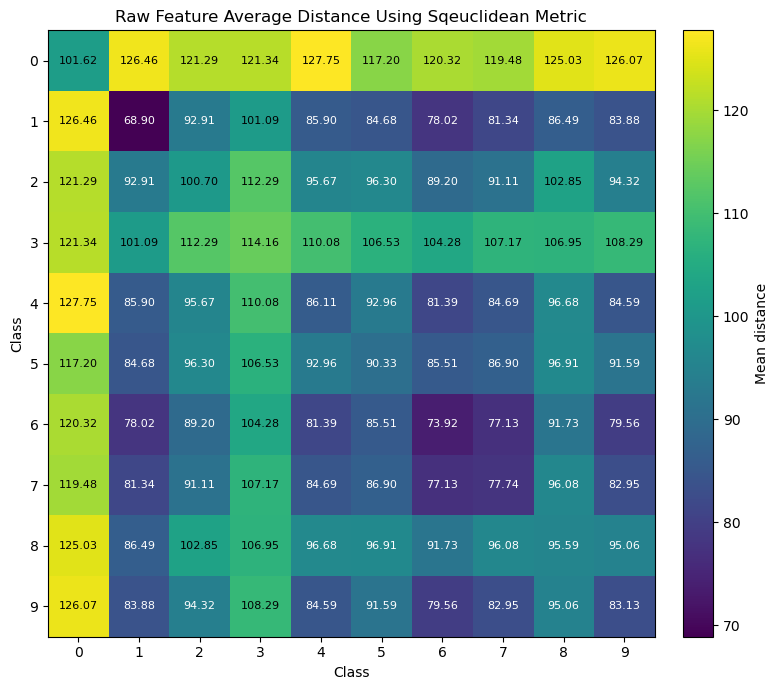

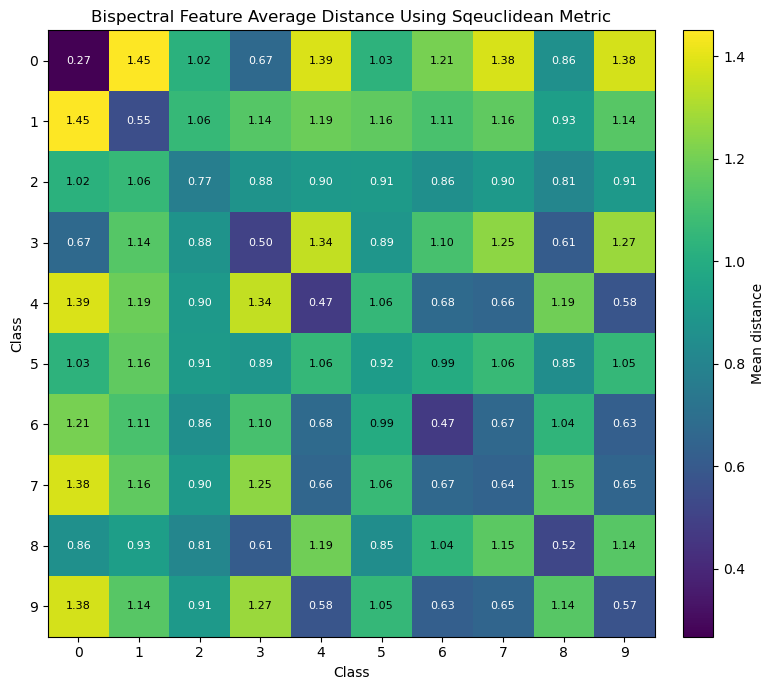

In [27]:
outdir = str(Path.cwd() / "experiment_photos/distance_conf_mats_by_digit_seed8")

metrics = ['euclidean', 'cityblock', 'cosine', 'sqeuclidean']

for m in metrics:
    per_class_xs, classes = class_distance_confusion(prep_9, metric=m, which="xs")
    per_class_bs, _ = class_distance_confusion(prep_9, metric=m, which="bs")

    plot_distance_heatmap2(
        per_class_xs,
        classes,
        title=f"Raw Feature Average Distance Using {m.capitalize()} Metric", 
        save_path = os.path.join(outdir, f"xs_{m}_cf.png")
    )

    plot_distance_heatmap2(
        per_class_bs,
        classes,
        title=f"Bispectral Feature Average Distance Using {m.capitalize()} Metric", 
        save_path = os.path.join(outdir, f"bs_{m}_cf.png")
    )